In [1]:
!pip install nltk

In [2]:
!pip install scikit-learn


In [3]:
!pip install --upgrade pip setuptools wheel


In [4]:
import nltk
import matplotlib.pyplot as plt
from collections import Counter
import string
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [5]:
# Function to load Bangla text from a file
def load_human_written_text(file_path):
    with open('/content/Jadukor-Humayun Ahmed.txt', 'r', encoding='utf-8') as file:
        return file.read()

# Path to the text file
file_path = '/content/Jadukor-Humayun Ahmed.txt'

# Load the text from the file and store it in the 'text' variable
human_written_text = load_human_written_text(file_path)

# Print the text to verify
print(human_written_text)

আজ হাফ ইয়ারলি পরীক্ষার অংক খাতা দিয়েছে।

বাবলু পেয়েছে সাড়ে আট। শুধু তাই নয়, খাতার উপর লাল পেনসিল দিয়ে ধীরেন স্যার
বড় বড় করে লিখে দিয়েছেন, গবু। কী সর্বনাশ!

বাবলু খাতা উল্টে রাখল। যাতে গবু লেখাটা কারো চোখে না পড়ে। কিন্তু ধীরেন স্যার
মেঘস্বরে বললেন, এই, বেঞ্চির উপর উঠে দাঁড়া।

বাবুল বেঞ্চির উপর উঠে দাঁড়াল। তোর অংক খাতায় কী লিখে দিয়েছি সবাইকে দেখা।

সে মুখ কালো করে সবাইকে দেখাল খাতাটা। ফাস্ট বেঞ্চে বসা কয়েকজন ভ্যাকভ্যাক

করে হেসে ফেলল। ধীরেন স্যার গর্জন করে উঠলেন। গ্যাই, কে হাসে! মুখ সেলাই করে
দেব।

হাসি বন্ধ হয়ে গেল সঙ্গে সঙ্গে। ধীরেন স্যারকে সবাই যমের মতো ভয় করে। আড়ালে
ডাকে যম স্যার। ফার্স্ট বেঞ্চে আবার একটু খিকখিক শব্দ হল। ধীরেন স্যার হুংকার দিয়ে
উঠলেন। আরেকবার হাসির শব্দ শুনলে চড় দিয়ে দাঁত খুলে ফেলব। নাট্যশালা নাকি?
এ?

ক্লাস পুরোপুরি নিঃশব্দ হয়ে গেল। ধীরেন স্যার থমথমে গলায় বললেন, এ্াই বাবলু, তুই
ঘণ্টা না পড়া পর্যন্ত বেঞ্চির উপর দাঁড়িয়ে থাকবি।


বাবলু উদাস চোখে জানালা দিয়ে বাইরে তাকিয়ে রইল। বেঞ্ির উপর এক ঘণ্টা দাঁড়িয়ে
থাকা তেমন কিছু না। কিন্তু বাসায় ফিরে

In [6]:
def bangla_sentence_tokenize(human_written_text):
    # Split sentences by full stop (।) used in Bangla
    sentences = human_written_text.split('।')
    sentences = human_written_text.split('\n\n')
    sentences = human_written_text.split('\n')
    return [sentence.strip() for sentence in sentences if sentence.strip()]

In [7]:
def bangla_word_tokenize(human_written_text):
    # Split words by spaces
    words = human_written_text.split()

    # Remove any leading/trailing whitespace and filter out empty strings
    words = [word.strip() for word in words if word.strip()]

    # Print the total number of words
    total_words = len(words)
    print(f"Total number of words: {total_words}")

    return words, total_words  # Also returning the total number of words


In [8]:
def preprocess_text(human_written_text):
    # Remove punctuation (you might want to keep Bangla-specific punctuation like "।")
    translator = str.maketrans('', '', string.punctuation)
    human_written_text = human_written_text.translate(translator)

    # Tokenize sentences using the custom function
    sentences = bangla_sentence_tokenize(human_written_text)

    # Tokenize words using the custom function
    words, total_words = bangla_word_tokenize(human_written_text) # Modified to correctly capture the two return values

    return words, total_words, sentences # Added total_words to the return statement


words, total_words, sentences = preprocess_text(human_written_text)
print(words)
print(total_words)
print(sentences)

Total number of words: 1586
['আজ', 'হাফ', 'ইয়ারলি', 'পরীক্ষার', 'অংক', 'খাতা', 'দিয়েছে।', 'বাবলু', 'পেয়েছে', 'সাড়ে', 'আট।', 'শুধু', 'তাই', 'নয়', 'খাতার', 'উপর', 'লাল', 'পেনসিল', 'দিয়ে', 'ধীরেন', 'স্যার', 'বড়', 'বড়', 'করে', 'লিখে', 'দিয়েছেন', 'গবু।', 'কী', 'সর্বনাশ', 'বাবলু', 'খাতা', 'উল্টে', 'রাখল।', 'যাতে', 'গবু', 'লেখাটা', 'কারো', 'চোখে', 'না', 'পড়ে।', 'কিন্তু', 'ধীরেন', 'স্যার', 'মেঘস্বরে', 'বললেন', 'এই', 'বেঞ্চির', 'উপর', 'উঠে', 'দাঁড়া।', 'বাবুল', 'বেঞ্চির', 'উপর', 'উঠে', 'দাঁড়াল।', 'তোর', 'অংক', 'খাতায়', 'কী', 'লিখে', 'দিয়েছি', 'সবাইকে', 'দেখা।', 'সে', 'মুখ', 'কালো', 'করে', 'সবাইকে', 'দেখাল', 'খাতাটা।', 'ফাস্ট', 'বেঞ্চে', 'বসা', 'কয়েকজন', 'ভ্যাকভ্যাক', 'করে', 'হেসে', 'ফেলল।', 'ধীরেন', 'স্যার', 'গর্জন', 'করে', 'উঠলেন।', 'গ্যাই', 'কে', 'হাসে', 'মুখ', 'সেলাই', 'করে', 'দেব।', 'হাসি', 'বন্ধ', 'হয়ে', 'গেল', 'সঙ্গে', 'সঙ্গে।', 'ধীরেন', 'স্যারকে', 'সবাই', 'যমের', 'মতো', 'ভয়', 'করে।', 'আড়ালে', 'ডাকে', 'যম', 'স্যার।', 'ফার্স্ট', 'বেঞ্চে', 'আবার', 'একটু', 'খিকখিক', 'শব্দ', 

In [9]:
# Function to load Bangla text from a file
def load_human_written_text(file_path):
    with open('/content/Jadukor-Humayun Ahmed.txt', 'r', encoding='utf-8') as file:
        return file.read()

# Path to the text file
file_path = '/content/Jadukor-Humayun Ahmed.txt'

# Load the text from the file and store it in the 'text' variable
human_written_text = load_human_written_text(file_path)

# Print the text to verify
print(human_written_text)

আজ হাফ ইয়ারলি পরীক্ষার অংক খাতা দিয়েছে।

বাবলু পেয়েছে সাড়ে আট। শুধু তাই নয়, খাতার উপর লাল পেনসিল দিয়ে ধীরেন স্যার
বড় বড় করে লিখে দিয়েছেন, গবু। কী সর্বনাশ!

বাবলু খাতা উল্টে রাখল। যাতে গবু লেখাটা কারো চোখে না পড়ে। কিন্তু ধীরেন স্যার
মেঘস্বরে বললেন, এই, বেঞ্চির উপর উঠে দাঁড়া।

বাবুল বেঞ্চির উপর উঠে দাঁড়াল। তোর অংক খাতায় কী লিখে দিয়েছি সবাইকে দেখা।

সে মুখ কালো করে সবাইকে দেখাল খাতাটা। ফাস্ট বেঞ্চে বসা কয়েকজন ভ্যাকভ্যাক

করে হেসে ফেলল। ধীরেন স্যার গর্জন করে উঠলেন। গ্যাই, কে হাসে! মুখ সেলাই করে
দেব।

হাসি বন্ধ হয়ে গেল সঙ্গে সঙ্গে। ধীরেন স্যারকে সবাই যমের মতো ভয় করে। আড়ালে
ডাকে যম স্যার। ফার্স্ট বেঞ্চে আবার একটু খিকখিক শব্দ হল। ধীরেন স্যার হুংকার দিয়ে
উঠলেন। আরেকবার হাসির শব্দ শুনলে চড় দিয়ে দাঁত খুলে ফেলব। নাট্যশালা নাকি?
এ?

ক্লাস পুরোপুরি নিঃশব্দ হয়ে গেল। ধীরেন স্যার থমথমে গলায় বললেন, এ্াই বাবলু, তুই
ঘণ্টা না পড়া পর্যন্ত বেঞ্চির উপর দাঁড়িয়ে থাকবি।


বাবলু উদাস চোখে জানালা দিয়ে বাইরে তাকিয়ে রইল। বেঞ্ির উপর এক ঘণ্টা দাঁড়িয়ে
থাকা তেমন কিছু না। কিন্তু বাসায় ফিরে

In [10]:
!pip install BnLemma

In [11]:
import BnLemma as lm
import string

# Define a list of Bangla stop words (you can extend this list as needed)
bangla_stop_words = ['এ', 'ও', 'আছে', 'থেকে', 'কিন্তু', 'যা', 'যে', 'এবং', 'এই', 'ওই', 'হয়', 'সে', 'আমি', 'আমরা', 'তুমি', 'তারা']

# Function to tokenize and lemmatize Bangla sentences
def bangla_sentence_tokenize(human_written_text):
    # Initialize the BnLemma lemmatizer
    bl = lm.Lemmatizer()

    # Split sentences by full stop (।) and newline characters
    sentences = human_written_text.split('।')
    sentences = [sentence for sublist in [s.split('\n\n') for s in sentences] for sentence in sublist]
    sentences = [sentence for sublist in [s.split('\n') for s in sentences] for sentence in sublist]

    # Strip and filter empty sentences
    sentences = [sentence.strip() for sentence in sentences if sentence.strip()]

    # Lemmatize each sentence, avoiding empty or problematic sentences
    lemmatized_sentences = []
    for sentence in sentences:
        if sentence:  # Ensure sentence is not empty
            try:
                lemmatized_sentence = bl.lemma(sentence)
                lemmatized_sentences.append(lemmatized_sentence)
            except KeyError as e:
                print(f"Error lemmatizing sentence: {sentence}, skipping. Error: {e}")

    # Return the list of lemmatized sentences
    return lemmatized_sentences

# Function to remove stop words and count words
def remove_stop_words(sentences):
    # Lists to hold sentences after stop word removal
    cleaned_sentences = []

    # Initialize counters
    total_words = 0
    remaining_words = 0
    total_removed_words = 0

    # Total number of sentences
    total_sentences = len(sentences)

    # Iterate over each sentence
    for sentence in sentences:
        # Tokenize the sentence into words
        words = sentence.split()

        # Count the total number of words
        total_words += len(words)

        # Remove stop words from the sentence
        filtered_words = [word for word in words if word not in bangla_stop_words]

        # Count the number of removed stop words
        removed_words_count = len(words) - len(filtered_words)
        total_removed_words += removed_words_count

        # Count the number of remaining words after removing stop words
        remaining_words += len(filtered_words)

        # Join the words back into a cleaned sentence
        cleaned_sentence = ' '.join(filtered_words)

        # Add the cleaned sentence to the list
        cleaned_sentences.append(cleaned_sentence)

    # Print the cleaned sentences
    print("Cleaned Sentences:", cleaned_sentences)

    # Print total and remaining word counts
    print(f"Total words: {total_words}")
    print(f"Remaining words after stop word removal: {remaining_words}")
    print(f"Total stop words removed: {total_removed_words}")
    print(f"Total sentences: {total_sentences}")

    return cleaned_sentences

# Preprocessing function to remove punctuation and lemmatize
def preprocess_text(human_written_text):
    # Remove punctuation (you might want to adjust for Bangla-specific punctuation)
    translator = str.maketrans('', '', string.punctuation)
    human_written_text = human_written_text.translate(translator)

    # Tokenize and lemmatize sentences using the custom function
    sentences = bangla_sentence_tokenize(human_written_text)

    return sentences


# Preprocess the text
sentences = preprocess_text(human_written_text)
# Remove stop words from the sentences and print results
cleaned_sentences = remove_stop_words(sentences)


Error lemmatizing sentence: রাগী গলায় বললেন এই বয়সে বদরামি, skipping. Error: ''
Cleaned Sentences: ['আজ হাফ ইয়ারলি পরীক্ষা অংক খাতা দিয়েছে', 'বাবলা পেয়েছে সাড়ে আট', 'শুধু তাই নয় খাতা উপর লাল পেনসিল দেওয়া ধীর যার', 'বড় বড় করা লিখে দিয়েছেন গবু', 'কী সর্বনাশ', 'বাবলা খাতা উল্টে খল', 'যাতা গবু লেখাপড়া কারো চোখ না পড়ে', 'ধীর যার', 'স্বর লেন বেঞ্চ উপর উঠে দাঁড়া', 'বাবু বেঞ্চ উপর উঠে দাঁড়া', 'আপনার অংক খাতা কী লিখে দিয়েছি সবাই দেখা', 'মুখ কালো করা সবাই দেখা খাতা', 'ফাস্ট বেঞ্চ বসা কয়েকজন ভ্যাকসিন', 'করা ফেল', 'ধীর যার গর্জন করা লেন', 'গ্যাঁট কে হাস মুখ সেলাই করা', 'দেব', 'হাসি বন্ধ হ গেল সঙ্গে সঙ্গে', 'ধীর স্যার সবাই যম মত ভয় করা', 'আড়ালে', 'ডাক যম যার', 'ফার্স্ট বেঞ্চ আবার একটু খিকখিক শব্দ হওয়া', 'ধীর যার হুংকার দেওয়া', 'লেন', 'আরেক হাসি শব্দ শুনা চড় দেওয়া দাঁত খোলা ফেল', 'নাট্য নাকি', '', 'ক্লাস পুরো নিঃশব্দ হ গেল', 'ধীর যার থমথম গলা লেন বাবলা আপনি', 'ঘণ্টা না পড়া পর্যন্ত বেঞ্চ উপর দাঁড়ি থাক', 'বাবলা দাস চোখ জানাজা দেওয়া বাই তাক রইল', 'বেঞ্ির উপর এক ঘণ্টা দাঁড়ি', 'থাকা 

In [12]:
from itertools import combinations

# Function to create word pairs from a cleaned sentence
def create_word_pairs(cleaned_sentences):
    for sentence in cleaned_sentences:
        words = sentence.split()  # Tokenize the cleaned sentence into words

        # Generate pairs of words
        word_pairs = list(combinations(words, 2))  # Create pairs using combinations

        # Print the pairs and the count of pairs
        print(f"Sentence: '{sentence}'")
        print(f"Word Pairs: {word_pairs}")
        print(f"Number of pairs: {len(word_pairs)}\n")


create_word_pairs(cleaned_sentences)


Sentence: 'আজ হাফ ইয়ারলি পরীক্ষা অংক খাতা দিয়েছে'
Word Pairs: [('আজ', 'হাফ'), ('আজ', 'ইয়ারলি'), ('আজ', 'পরীক্ষা'), ('আজ', 'অংক'), ('আজ', 'খাতা'), ('আজ', 'দিয়েছে'), ('হাফ', 'ইয়ারলি'), ('হাফ', 'পরীক্ষা'), ('হাফ', 'অংক'), ('হাফ', 'খাতা'), ('হাফ', 'দিয়েছে'), ('ইয়ারলি', 'পরীক্ষা'), ('ইয়ারলি', 'অংক'), ('ইয়ারলি', 'খাতা'), ('ইয়ারলি', 'দিয়েছে'), ('পরীক্ষা', 'অংক'), ('পরীক্ষা', 'খাতা'), ('পরীক্ষা', 'দিয়েছে'), ('অংক', 'খাতা'), ('অংক', 'দিয়েছে'), ('খাতা', 'দিয়েছে')]
Number of pairs: 21

Sentence: 'বাবলা পেয়েছে সাড়ে আট'
Word Pairs: [('বাবলা', 'পেয়েছে'), ('বাবলা', 'সাড়ে'), ('বাবলা', 'আট'), ('পেয়েছে', 'সাড়ে'), ('পেয়েছে', 'আট'), ('সাড়ে', 'আট')]
Number of pairs: 6

Sentence: 'শুধু তাই নয় খাতা উপর লাল পেনসিল দেওয়া ধীর যার'
Word Pairs: [('শুধু', 'তাই'), ('শুধু', 'নয়'), ('শুধু', 'খাতা'), ('শুধু', 'উপর'), ('শুধু', 'লাল'), ('শুধু', 'পেনসিল'), ('শুধু', 'দেওয়া'), ('শুধু', 'ধীর'), ('শুধু', 'যার'), ('তাই', 'নয়'), ('তাই', 'খাতা'), ('তাই', 'উপর'), ('তাই', 'লাল'), ('তাই', 'পেনসিল'), ('তাই'

In [13]:
from collections import defaultdict
from itertools import combinations

# Function to check frequency of word pairs from cleaned sentences
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)  # Create a default dictionary to count pairs

    for sentence in cleaned_sentences:
        words = sentence.split()  # Tokenize the cleaned sentence into words
        word_pairs = combinations(words, 2)  # Create pairs using combinations

        # Count each pair's frequency
        for pair in word_pairs:
            pair_frequency[pair] += 1

    # Print the frequency of each pair if frequency > 1
    print("Pairs with Frequency > 1:")
    for pair, frequency in pair_frequency.items():
        if frequency > 1:  # Only print if frequency is greater than 1
            print(f"Pair: {pair}, Frequency: {frequency}")

check_pair_frequency(cleaned_sentences)  # Call the function



Pairs with Frequency > 1:
Pair: ('অংক', 'খাতা'), Frequency: 2
Pair: ('বাবলা', 'সাড়ে'), Frequency: 2
Pair: ('বাবলা', 'আট'), Frequency: 2
Pair: ('সাড়ে', 'আট'), Frequency: 3
Pair: ('খাতা', 'উপর'), Frequency: 4
Pair: ('খাতা', 'দেওয়া'), Frequency: 2
Pair: ('ধীর', 'যার'), Frequency: 8
Pair: ('বড়', 'বড়'), Frequency: 2
Pair: ('বড়', 'করা'), Frequency: 4
Pair: ('বড়', 'লিখে'), Frequency: 2
Pair: ('বড়', 'দিয়েছেন'), Frequency: 2
Pair: ('বড়', 'গবু'), Frequency: 2
Pair: ('বাবলা', 'খাতা'), Frequency: 2
Pair: ('স্বর', 'লেন'), Frequency: 2
Pair: ('বেঞ্চ', 'উপর'), Frequency: 3
Pair: ('বেঞ্চ', 'উঠে'), Frequency: 2
Pair: ('বেঞ্চ', 'দাঁড়া'), Frequency: 2
Pair: ('উপর', 'উঠে'), Frequency: 2
Pair: ('উপর', 'দাঁড়া'), Frequency: 2
Pair: ('উঠে', 'দাঁড়া'), Frequency: 2
Pair: ('আপনার', 'কী'), Frequency: 3
Pair: ('অংক', 'কী'), Frequency: 2
Pair: ('সবাই', 'দেখা'), Frequency: 2
Pair: ('মুখ', 'কালো'), Frequency: 4
Pair: ('মুখ', 'করা'), Frequency: 6
Pair: ('কালো', 'করা'), Frequency: 5
Pair: ('করা', 'দেখা'), F

In [14]:
pip install networkx matplotlib


# EDGES BETWEEN THE NODES THAT ARE NOT REPEATED IN A SENTENCE

Total number of nodes: 131


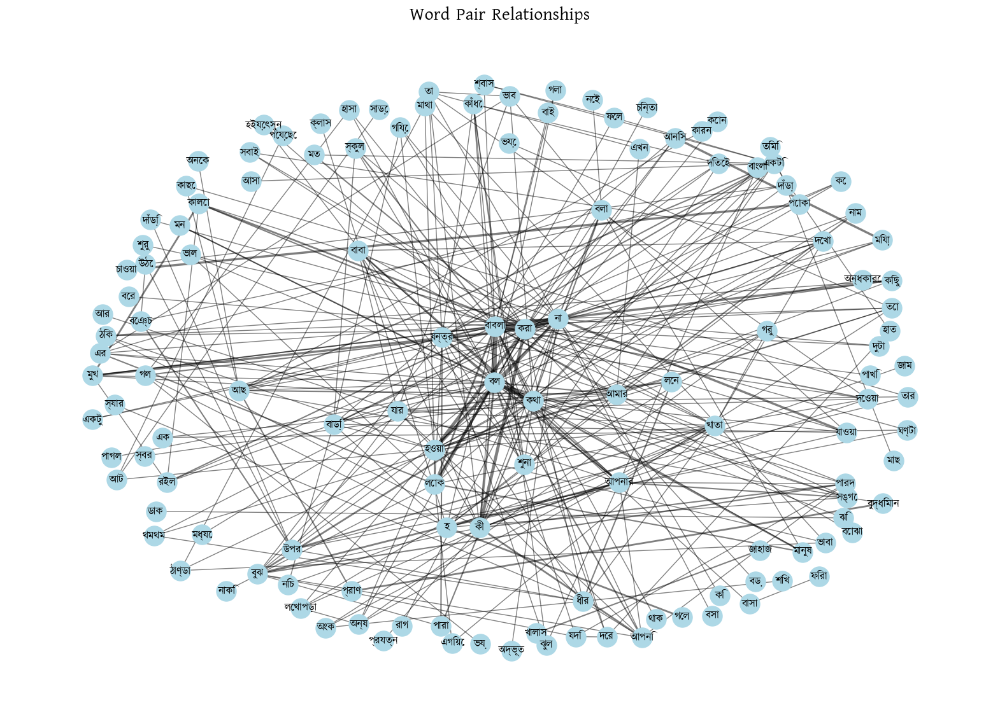

In [15]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to plot word pairs with Bangla labels
def plot_word_pairs(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    pos = nx.spring_layout(G, k=2)
    weights = nx.get_edge_attributes(G, 'weight').values()

    plt.figure(figsize=(20, 14))

    nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightblue')
    nx.draw_networkx_edges(G, pos, width=[w / 2 for w in weights], alpha=0.5)

    # Draw Bangla labels
    nx.draw_networkx_labels(G, pos, font_size=12, font_family=plt.rcParams['font.family'])

    plt.title('Word Pair Relationships', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
    plt.axis('off')
    plt.show()


# Path to the Kalpurush font
font_path = 'kalpurush.ttf'

# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Plot word pairs with Bangla labels
plot_word_pairs(pair_frequency, font_path)


In [16]:
!pip install gensim matplotlib scikit-learn


# WORD 2 VEC EMBEDDING OF THE WORDS

Total number of nodes: 131


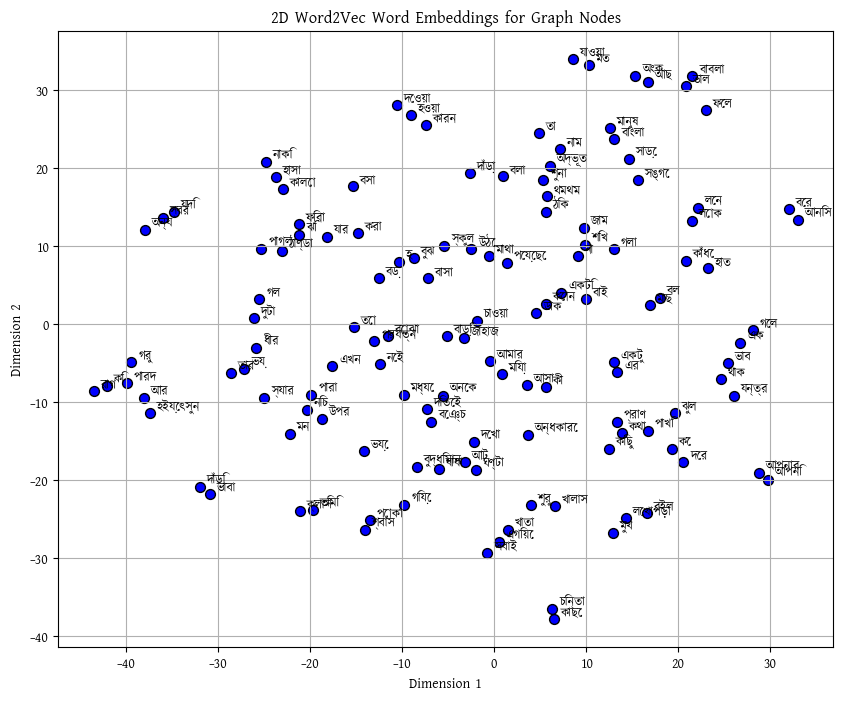

In [17]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
from sklearn.manifold import TSNE
from gensim.models import Word2Vec
import numpy as np
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to plot word pairs with Bangla labels
def plot_word_pairs(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    return G

# Function to plot Word2Vec embeddings of the nodes
def plot_word2vec(cleaned_sentences, graph_nodes, vector_size=100, window=5, min_count=1, perplexity=5):
    # Split the cleaned sentences into lists of words
    tokenized_sentences = [sentence.split() for sentence in cleaned_sentences]

    # Train the Word2Vec model
    model = Word2Vec(sentences=tokenized_sentences, vector_size=vector_size, window=window, min_count=min_count)

    # Get the word vectors and corresponding words
    word_vectors = model.wv
    words = graph_nodes  # Use only the words that are nodes in the graph
    vectors = np.array([word_vectors[word] for word in words if word in word_vectors])

    # Reduce the dimensionality to 2D using t-SNE with adjusted perplexity
    tsne = TSNE(n_components=2, random_state=42, perplexity=min(perplexity, len(words) - 1))  # Ensure perplexity < n_samples
    vectors_2d = tsne.fit_transform(vectors)

    # Plot the words in the 2D space
    plt.figure(figsize=(10, 8))
    plt.scatter(vectors_2d[:, 0], vectors_2d[:, 1], marker='o', c='blue', edgecolor='k', s=50)

    # Annotate each word at its position
    for i, word in enumerate(words):
        plt.annotate(word, xy=(vectors_2d[i, 0], vectors_2d[i, 1]), xytext=(5, 2), textcoords='offset points', fontsize=9)

    # Display the plot
    plt.title('2D Word2Vec Word Embeddings for Graph Nodes')
    plt.xlabel('Dimension 1')
    plt.ylabel('Dimension 2')
    plt.grid(True)
    plt.show()


# Path to the Kalpurush font
font_path = 'kalpurush.ttf'

# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Create graph from word pairs
graph = plot_word_pairs(pair_frequency, font_path)

# Extract the nodes (unique words) from the graph
graph_nodes = list(graph.nodes)

# Plot Word2Vec embeddings for the graph nodes
plot_word2vec(cleaned_sentences, graph_nodes)


# COSINE SIMILARITY

The cosine similarity between two vectors
𝐴
A and
𝐵
B is given by:

cosine similarity
(
𝐴
,
𝐵
)
=
𝐴
⋅
𝐵
∥
𝐴
∥
∥
𝐵
∥
cosine similarity(A,B)=
∥A∥∥B∥
A⋅B
​


Total number of nodes: 131


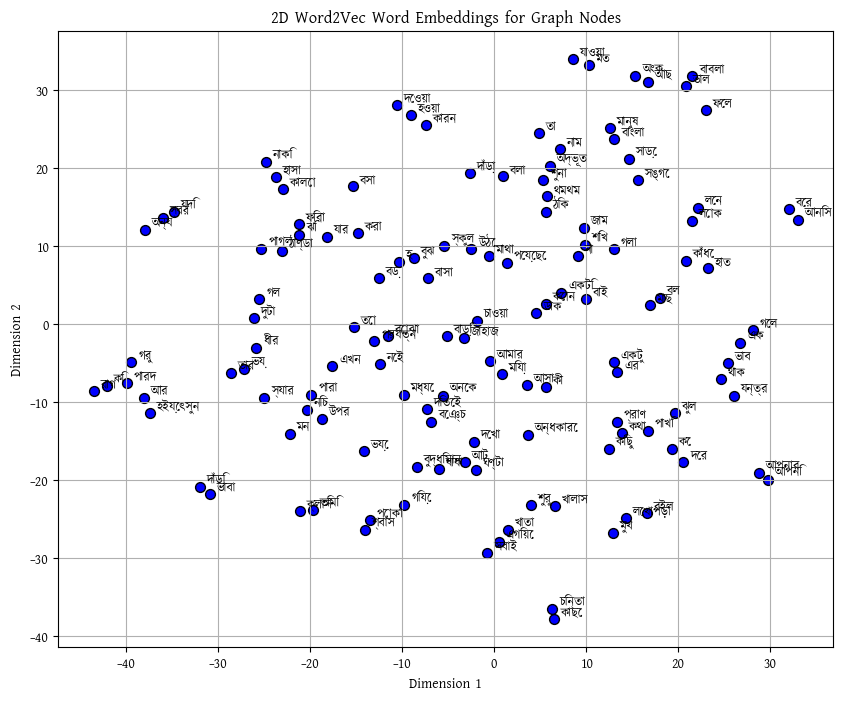

Total number of low similarity nodes: 131


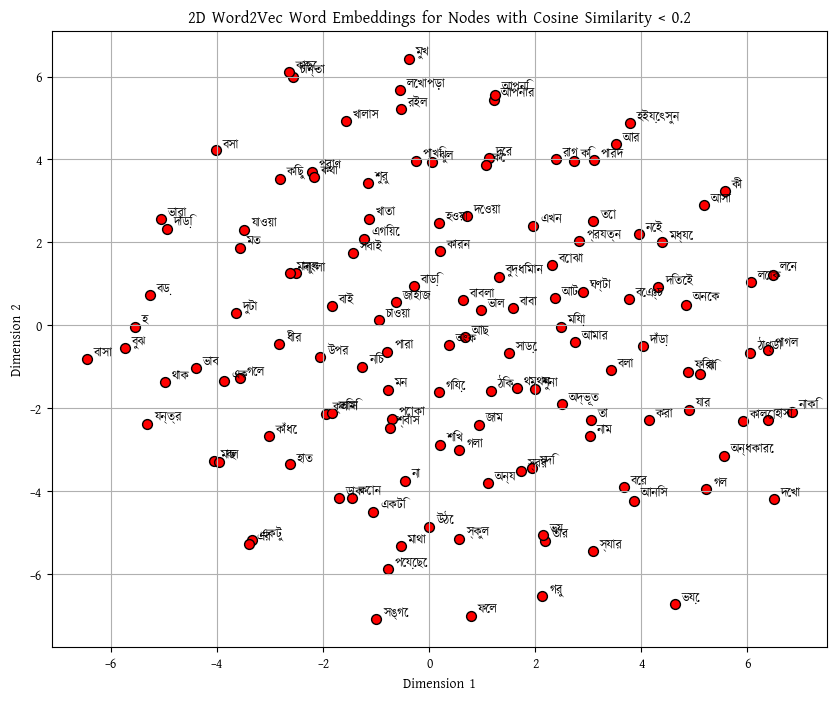

Streaming output truncated to the last 5000 lines.
আপনি - মাথা: 0.0101
আপনি - খালাস: -0.0242
আপনি - জাহাজ: 0.0964
আপনি - নাম: 0.0995
আপনি - তো: 0.0023
আপনি - আমার: 0.1613
আপনি - অদ্ভূত: -0.0349
আপনি - কি: -0.0068
আপনি - একটু: -0.1868
আপনি - মানুষ: 0.0375
আপনি - কথা: 0.1162
আপনি - পাগল: -0.0350
আপনি - ভাল: -0.0760
আপনি - নাকি: 0.0467
আপনি - বোঝা: -0.0363
আপনি - বাংলা: 0.0069
আপনি - বুঝ: 0.0431
আপনি - কারন: -0.0249
আপনি - যন্ত্র: -0.0535
আপনি - আসা: -0.0664
আপনি - প্রাণ: 0.1309
আপনি - বুদ্ধিমান: -0.1730
আপনি - পারা: 0.0404
আপনি - তা: 0.0089
আপনি - এর: 0.0821
আপনি - পারদ: -0.1964
আপনি - যদি: -0.0956
আপনি - ঝুল: -0.0912
আপনি - কাঁধে: 0.0737
আপনি - ভয়ে: -0.0556
আপনি - শুনা: 0.0775
আপনি - হইয়েৎসুন: 0.0239
আপনি - দিতেই: 0.1304
আপনি - চাওয়া: 0.0036
আপনি - পোকা: -0.0954
আপনি - দুটা: -0.0566
আপনি - ভাব: -0.0327
আপনি - পাখি: 0.0357
আপনি - শুরু: -0.0448
আপনি - নেই: 0.0805
আপনি - দের: -0.0347
আপনি - এখন: 0.0403
আপনি - অনেক: 0.0101
আপনি - তিমি: -0.0589
আপনি - মাছ: 0.0438
আপনি - কোন: -0.1016
আপনি -

In [18]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
from sklearn.manifold import TSNE
from gensim.models import Word2Vec
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to plot word pairs with Bangla labels
def plot_word_pairs(pair_frequency, font_path):
    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    return G

# Function to plot Word2Vec embeddings of the nodes
def plot_word2vec(cleaned_sentences, graph_nodes, vector_size=100, window=5, min_count=1, perplexity=5):
    # Split the cleaned sentences into lists of words
    tokenized_sentences = [sentence.split() for sentence in cleaned_sentences]

    # Train the Word2Vec model
    model = Word2Vec(sentences=tokenized_sentences, vector_size=vector_size, window=window, min_count=min_count)

    # Get the word vectors and corresponding words
    word_vectors = model.wv
    words = graph_nodes  # Use only the words that are nodes in the graph
    vectors = np.array([word_vectors[word] for word in words if word in word_vectors])

    # Reduce the dimensionality to 2D using t-SNE with adjusted perplexity
    tsne = TSNE(n_components=2, random_state=42, perplexity=min(perplexity, len(words) - 1))  # Ensure perplexity < n_samples
    vectors_2d = tsne.fit_transform(vectors)

    # Plot the words in the 2D space
    plt.figure(figsize=(10, 8))
    plt.scatter(vectors_2d[:, 0], vectors_2d[:, 1], marker='o', c='blue', edgecolor='k', s=50)

    # Annotate each word at its position
    for i, word in enumerate(words):
        plt.annotate(word, xy=(vectors_2d[i, 0], vectors_2d[i, 1]), xytext=(5, 2), textcoords='offset points', fontsize=9)

    # Display the plot
    plt.title('2D Word2Vec Word Embeddings for Graph Nodes')
    plt.xlabel('Dimension 1')
    plt.ylabel('Dimension 2')
    plt.grid(True)
    plt.show()

# Function to plot nodes with cosine similarity < threshold
def plot_low_similarity_nodes(cleaned_sentences, graph_nodes, G, vector_size=100, window=5, min_count=1, threshold=0.2):
    # Split the cleaned sentences into lists of words
    tokenized_sentences = [sentence.split() for sentence in cleaned_sentences]

    # Train the Word2Vec model
    model = Word2Vec(sentences=tokenized_sentences, vector_size=vector_size, window=window, min_count=min_count)

    # Get the word vectors and corresponding words
    word_vectors = model.wv
    words = graph_nodes  # Use only the words that are nodes in the graph
    vectors = np.array([word_vectors[word] for word in words if word in word_vectors])

    # Compute cosine similarity between all pairs of words
    cosine_sim = cosine_similarity(vectors)

    # Find word pairs with cosine similarity less than the threshold (e.g., 0.2)
    low_similarity_pairs = []
    for i in range(len(cosine_sim)):
        for j in range(i + 1, len(cosine_sim)):  # To avoid duplicate pairs
            if cosine_sim[i, j] < threshold:
                low_similarity_pairs.append((words[i], words[j], cosine_sim[i, j]))

    # Plot the low similarity nodes
    low_similarity_words = set([pair[0] for pair in low_similarity_pairs] + [pair[1] for pair in low_similarity_pairs])

    # Create a subgraph with low similarity words
    low_similarity_graph = G.subgraph(low_similarity_words)

    # Get the total number of nodes
    total_nodes = len(low_similarity_graph.nodes)
    print(f"Total number of low similarity nodes: {total_nodes}")  # Print the number of nodes with low similarity

    # Prepare the 2D positions for t-SNE
    low_similarity_vectors = np.array([word_vectors[word] for word in low_similarity_words if word in word_vectors])
    tsne = TSNE(n_components=2, random_state=42)
    low_similarity_vectors_2d = tsne.fit_transform(low_similarity_vectors)

    # Plot the low similarity words in the 2D space
    plt.figure(figsize=(10, 8))
    plt.scatter(low_similarity_vectors_2d[:, 0], low_similarity_vectors_2d[:, 1], marker='o', c='red', edgecolor='k', s=50)

    # Annotate each low similarity word at its position
    for i, word in enumerate(low_similarity_words):
        plt.annotate(word, xy=(low_similarity_vectors_2d[i, 0], low_similarity_vectors_2d[i, 1]), xytext=(5, 2), textcoords='offset points', fontsize=9)

    # Display the plot
    plt.title(f'2D Word2Vec Word Embeddings for Nodes with Cosine Similarity < {threshold}')
    plt.xlabel('Dimension 1')
    plt.ylabel('Dimension 2')
    plt.grid(True)
    plt.show()

# Function to print all cosine similarities
def print_cosine_similarities(cleaned_sentences, graph_nodes, vector_size=100, window=5, min_count=1):
    # Split the cleaned sentences into lists of words
    tokenized_sentences = [sentence.split() for sentence in cleaned_sentences]

    # Train the Word2Vec model
    model = Word2Vec(sentences=tokenized_sentences, vector_size=vector_size, window=window, min_count=min_count)

    # Get the word vectors and corresponding words
    word_vectors = model.wv
    words = graph_nodes  # Use only the words that are nodes in the graph
    vectors = np.array([word_vectors[word] for word in words if word in word_vectors])

    # Compute cosine similarity between all pairs of words
    cosine_sim = cosine_similarity(vectors)

    # Print all cosine similarities
    print("Cosine Similarities:")
    for i in range(len(cosine_sim)):
        for j in range(i + 1, len(cosine_sim)):  # Avoid duplicate pairs
            print(f"{words[i]} - {words[j]}: {cosine_sim[i, j]:.4f}")


# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Create graph from word pairs
graph = plot_word_pairs(pair_frequency, 'kalpurush.ttf')

# Extract the nodes (unique words) from the graph
graph_nodes = list(graph.nodes)

# Plot Word2Vec embeddings for the graph nodes
plot_word2vec(cleaned_sentences, graph_nodes)

# Plot nodes with cosine similarity < 0.2
plot_low_similarity_nodes(cleaned_sentences, graph_nodes, graph, threshold=0.2)

# Print all cosine similarities
print_cosine_similarities(cleaned_sentences, graph_nodes)


# COSINE SIMILARITY <0.1

Total number of nodes: 131


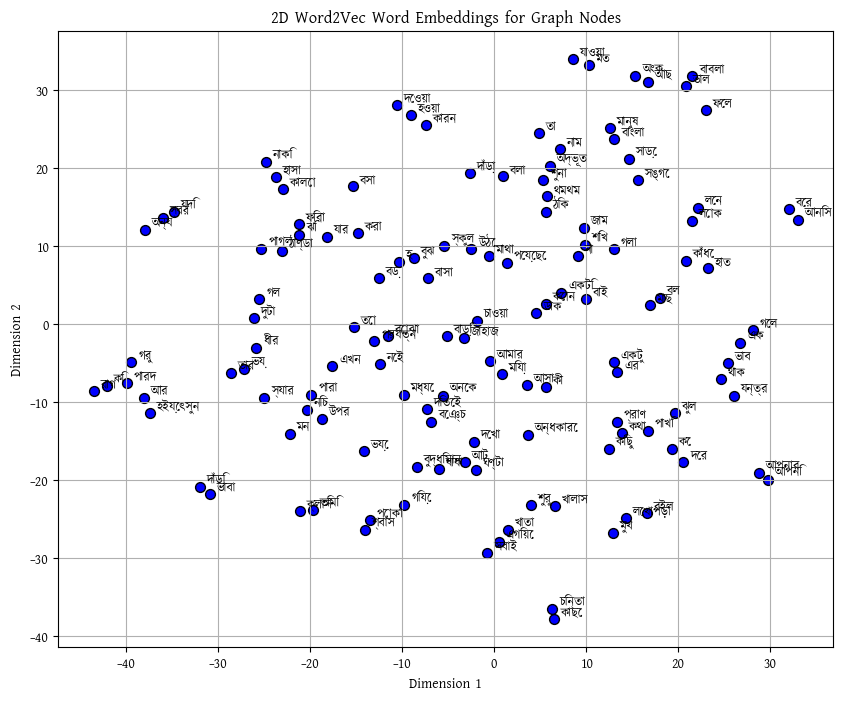

Total number of low similarity nodes: 131


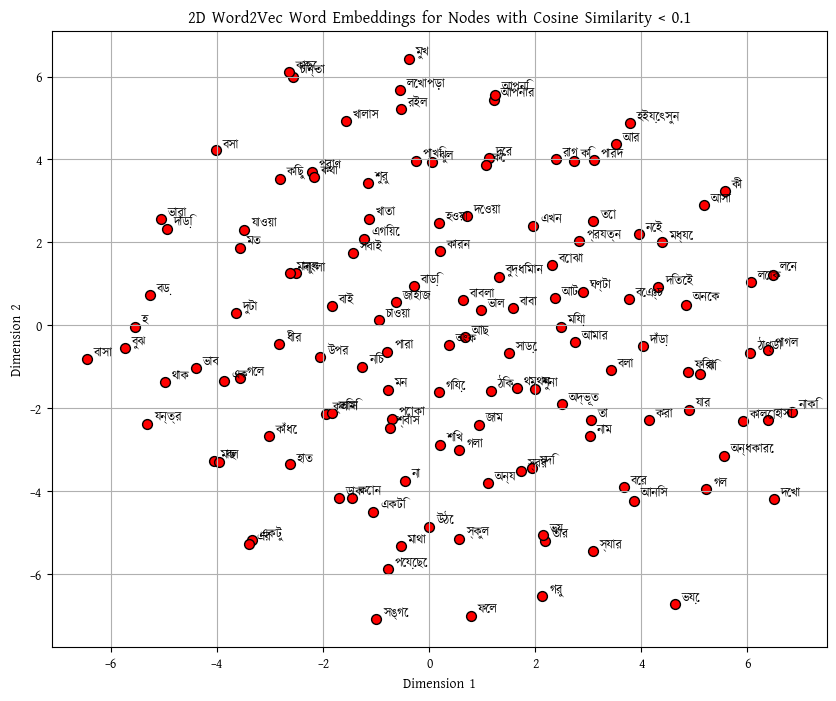

In [19]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
from sklearn.manifold import TSNE
from gensim.models import Word2Vec
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to plot word pairs with Bangla labels
def plot_word_pairs(pair_frequency, font_path):
    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    return G

# Function to plot Word2Vec embeddings of the nodes
def plot_word2vec(cleaned_sentences, graph_nodes, vector_size=100, window=5, min_count=1, perplexity=5):
    # Split the cleaned sentences into lists of words
    tokenized_sentences = [sentence.split() for sentence in cleaned_sentences]

    # Train the Word2Vec model
    model = Word2Vec(sentences=tokenized_sentences, vector_size=vector_size, window=window, min_count=min_count)

    # Get the word vectors and corresponding words
    word_vectors = model.wv
    words = graph_nodes  # Use only the words that are nodes in the graph
    vectors = np.array([word_vectors[word] for word in words if word in word_vectors])

    # Reduce the dimensionality to 2D using t-SNE with adjusted perplexity
    tsne = TSNE(n_components=2, random_state=42, perplexity=min(perplexity, len(words) - 1))  # Ensure perplexity < n_samples
    vectors_2d = tsne.fit_transform(vectors)

    # Plot the words in the 2D space
    plt.figure(figsize=(10, 8))
    plt.scatter(vectors_2d[:, 0], vectors_2d[:, 1], marker='o', c='blue', edgecolor='k', s=50)

    # Annotate each word at its position
    for i, word in enumerate(words):
        plt.annotate(word, xy=(vectors_2d[i, 0], vectors_2d[i, 1]), xytext=(5, 2), textcoords='offset points', fontsize=9)

    # Display the plot
    plt.title('2D Word2Vec Word Embeddings for Graph Nodes')
    plt.xlabel('Dimension 1')
    plt.ylabel('Dimension 2')
    plt.grid(True)
    plt.show()

# New function to plot nodes with cosine similarity < 0.1
def plot_low_similarity_nodes(cleaned_sentences, graph_nodes, G, vector_size=100, window=5, min_count=1, threshold=0.1):
    # Split the cleaned sentences into lists of words
    tokenized_sentences = [sentence.split() for sentence in cleaned_sentences]

    # Train the Word2Vec model
    model = Word2Vec(sentences=tokenized_sentences, vector_size=vector_size, window=window, min_count=min_count)

    # Get the word vectors and corresponding words
    word_vectors = model.wv
    words = graph_nodes  # Use only the words that are nodes in the graph
    vectors = np.array([word_vectors[word] for word in words if word in word_vectors])

    # Compute cosine similarity between all pairs of words
    cosine_sim = cosine_similarity(vectors)

    # Find word pairs with cosine similarity less than the threshold (e.g., 0.1)
    low_similarity_pairs = []
    for i in range(len(cosine_sim)):
        for j in range(i + 1, len(cosine_sim)):  # To avoid duplicate pairs
            if cosine_sim[i, j] < threshold:
                low_similarity_pairs.append((words[i], words[j], cosine_sim[i, j]))

    # Plot the low similarity nodes
    low_similarity_words = set([pair[0] for pair in low_similarity_pairs] + [pair[1] for pair in low_similarity_pairs])

    # Create a subgraph with low similarity words
    low_similarity_graph = G.subgraph(low_similarity_words)

    # Get the total number of nodes
    total_nodes = len(low_similarity_graph.nodes)
    print(f"Total number of low similarity nodes: {total_nodes}")  # Print the number of nodes with low similarity

    # Prepare the 2D positions for t-SNE
    low_similarity_vectors = np.array([word_vectors[word] for word in low_similarity_words if word in word_vectors])
    tsne = TSNE(n_components=2, random_state=42)
    low_similarity_vectors_2d = tsne.fit_transform(low_similarity_vectors)

    # Plot the low similarity words in the 2D space
    plt.figure(figsize=(10, 8))
    plt.scatter(low_similarity_vectors_2d[:, 0], low_similarity_vectors_2d[:, 1], marker='o', c='red', edgecolor='k', s=50)

    # Annotate each low similarity word at its position
    for i, word in enumerate(low_similarity_words):
        plt.annotate(word, xy=(low_similarity_vectors_2d[i, 0], low_similarity_vectors_2d[i, 1]), xytext=(5, 2), textcoords='offset points', fontsize=9)

    # Display the plot
    plt.title(f'2D Word2Vec Word Embeddings for Nodes with Cosine Similarity < {threshold}')
    plt.xlabel('Dimension 1')
    plt.ylabel('Dimension 2')
    plt.grid(True)
    plt.show()



# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Create graph from word pairs
graph = plot_word_pairs(pair_frequency, 'kalpurush.ttf')

# Extract the nodes (unique words) from the graph
graph_nodes = list(graph.nodes)

# Plot Word2Vec embeddings for the graph nodes
plot_word2vec(cleaned_sentences, graph_nodes)

# Plot nodes with cosine similarity < 0.1
plot_low_similarity_nodes(cleaned_sentences, graph_nodes, graph, threshold=0.1)


Total number of nodes: 131


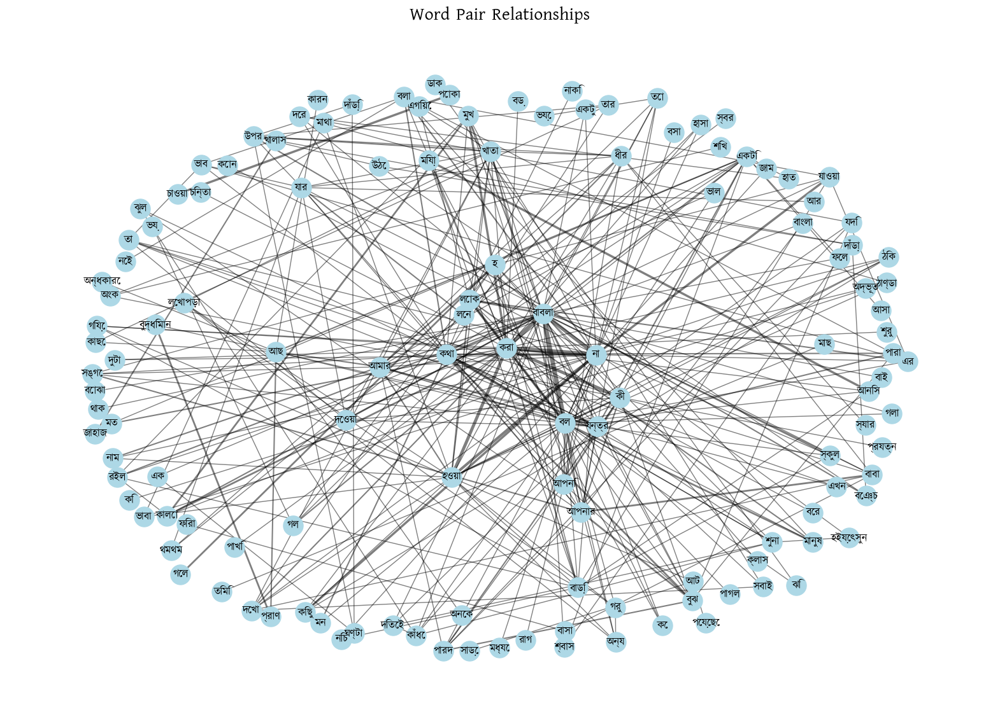

In [20]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to plot nodes with Bangla labels
def plot_nodes(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    pos = nx.spring_layout(G, k=2)
    weights = nx.get_edge_attributes(G, 'weight').values()

    plt.figure(figsize=(20, 14))

    # Draw network nodes
    nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightblue')

    # Draw edges with weights
    nx.draw_networkx_edges(G, pos, width=[w / 2 for w in weights], alpha=0.5)

    # Draw labels with Bangla font
    nx.draw_networkx_labels(G, pos, font_size=12, font_family=plt.rcParams['font.family'])

    plt.title('Word Pair Relationships', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
    plt.axis('off')
    plt.show()


# Path to the Kalpurush font (replace with your font path)
font_path = 'kalpurush.ttf'


# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Plot nodes with Bangla labels
plot_nodes(pair_frequency, font_path)


# DEGREE
### In graph theory, the degree (or valency) of a vertex of a graph is the number of edges that are incident to the vertex; in a multigraph, a loop contributes 2 to a vertex's degree, for the two ends of the edge.[1] The degree of a vertex
v
{\displaystyle v} is denoted
deg
⁡
(
v
)
{\displaystyle \deg(v)} or
deg
⁡
v
{\displaystyle \deg v}. The maximum degree of a graph
G
{\displaystyle G} is denoted by
Δ
(
G
)
{\displaystyle \Delta (G)}, and is the maximum of
G
{\displaystyle G}'s vertices' degrees. The minimum degree of a graph is denoted by
δ
(
G
)
{\displaystyle \delta (G)}, and is the minimum of
G
{\displaystyle G}'s vertices' degrees. In the multigraph shown on the right, the maximum degree is 5 and the minimum degree is 0.

### MAX DEGREE

Total number of nodes: 131
The node with the highest degree is: বাবলা with degree 34


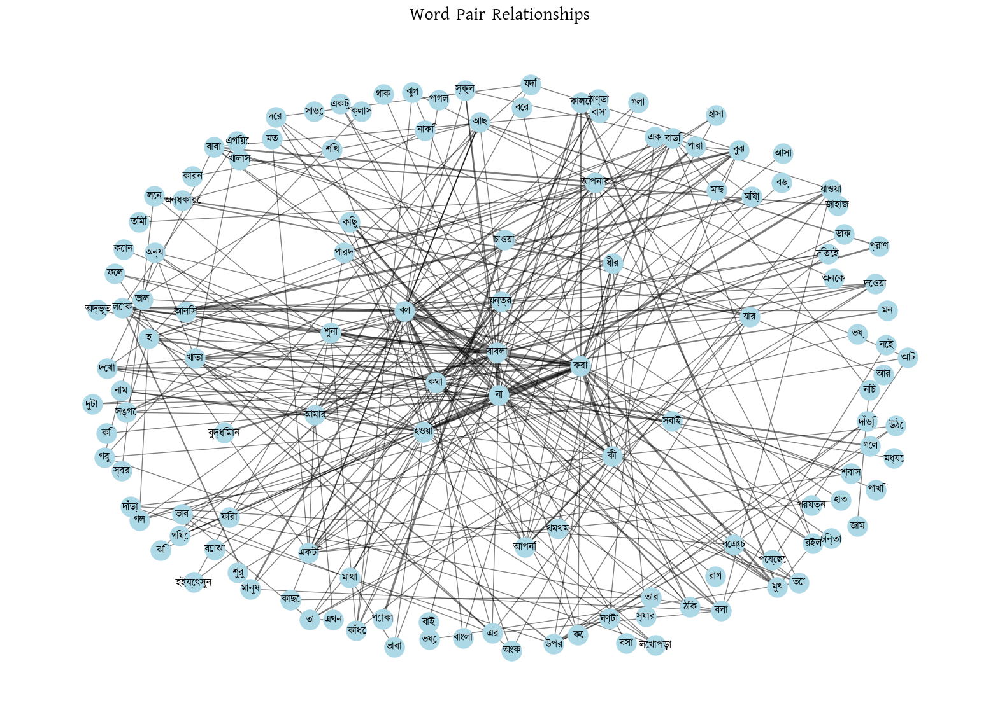

In [21]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to find the node with the highest degree in the graph
def find_highest_degree_node(pair_frequency):
    # Create a graph using the pair frequencies
    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:  # Consider edges that appear more than once
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Find the node with the highest degree
    degrees = G.degree()  # Get degree of each node
    highest_degree_node = max(degrees, key=lambda x: x[1])  # Find the node with the max degree

    return highest_degree_node

# Function to plot nodes with Bangla labels
def plot_nodes(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    # Find and print the node with the highest degree
    highest_degree_node = find_highest_degree_node(pair_frequency)
    print(f"The node with the highest degree is: {highest_degree_node[0]} with degree {highest_degree_node[1]}")

    pos = nx.spring_layout(G, k=2)
    weights = nx.get_edge_attributes(G, 'weight').values()

    plt.figure(figsize=(20, 14))

    # Draw network nodes
    nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightblue')

    # Draw edges with weights
    nx.draw_networkx_edges(G, pos, width=[w / 2 for w in weights], alpha=0.5)

    # Draw labels with Bangla font
    nx.draw_networkx_labels(G, pos, font_size=12, font_family=plt.rcParams['font.family'])

    plt.title('Word Pair Relationships', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
    plt.axis('off')
    plt.show()


# Example usage
# Path to the Kalpurush font (replace with your font path)
font_path = 'kalpurush.ttf'



# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Plot nodes with Bangla labels and print highest degree node
plot_nodes(pair_frequency, font_path)


Total number of nodes: 131
The node with the highest degree is: বাবলা with degree 34


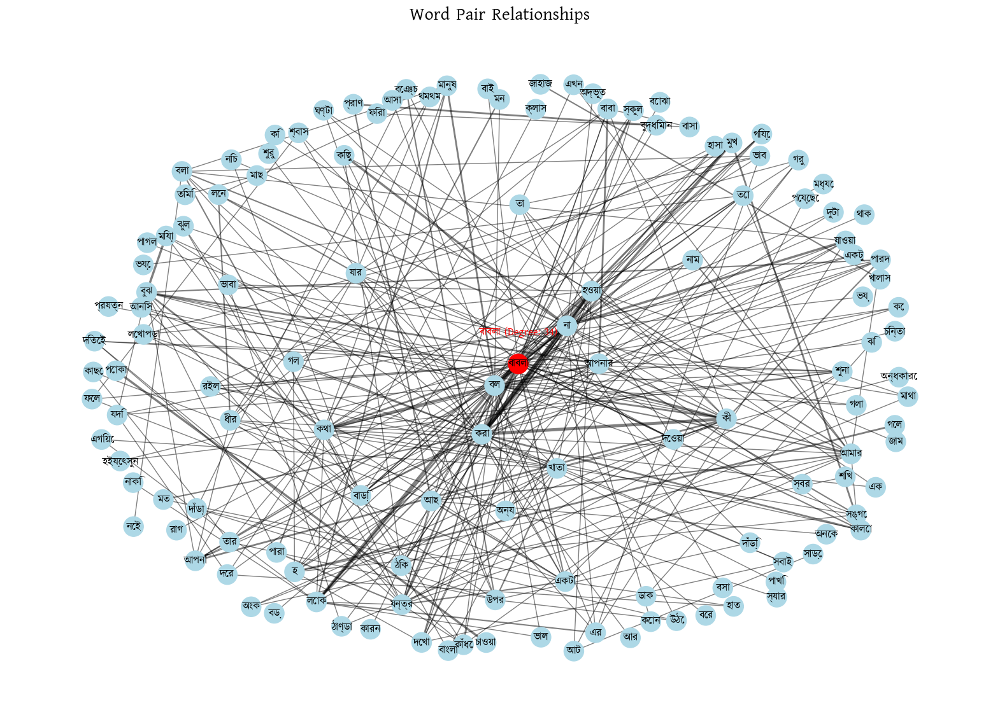

In [22]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to find the node with the highest degree in the graph
def find_highest_degree_node(pair_frequency):
    # Create a graph using the pair frequencies
    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:  # Consider edges that appear more than once
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Find the node with the highest degree
    degrees = G.degree()  # Get degree of each node
    highest_degree_node = max(degrees, key=lambda x: x[1])  # Find the node with the max degree

    return highest_degree_node

# Function to plot nodes with Bangla labels and highlight highest degree node
def plot_nodes(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    # Find and print the node with the highest degree
    highest_degree_node = find_highest_degree_node(pair_frequency)
    print(f"The node with the highest degree is: {highest_degree_node[0]} with degree {highest_degree_node[1]}")

    pos = nx.spring_layout(G, k=2)
    weights = nx.get_edge_attributes(G, 'weight').values()

    plt.figure(figsize=(20, 14))

    # Draw network nodes with a different color for the highest degree node
    node_colors = ['red' if node == highest_degree_node[0] else 'lightblue' for node in G.nodes()]
    nx.draw_networkx_nodes(G, pos, node_size=500, node_color=node_colors)

    # Draw edges with weights
    nx.draw_networkx_edges(G, pos, width=[w / 2 for w in weights], alpha=0.5)

    # Draw labels with Bangla font
    nx.draw_networkx_labels(G, pos, font_size=12, font_family=plt.rcParams['font.family'])

    # Annotate the highest degree node
    plt.text(
        pos[highest_degree_node[0]][0],
        pos[highest_degree_node[0]][1] + 0.1,
        f"{highest_degree_node[0]} (Degree: {highest_degree_node[1]})",
        fontsize=12, color='red', ha='center'
    )

    plt.title('Word Pair Relationships', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
    plt.axis('off')
    plt.show()


# Example usage
# Path to the Kalpurush font (replace with your font path)
font_path = 'kalpurush.ttf'


# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Plot nodes with Bangla labels and print highest degree node
plot_nodes(pair_frequency, font_path)


### MIN DEGREE ( MINIMUM DEGEEE NODE HAVE TO BE  >2 AND <=10)

Total number of nodes: 131
The node with the highest degree is: বাবলা with degree 34


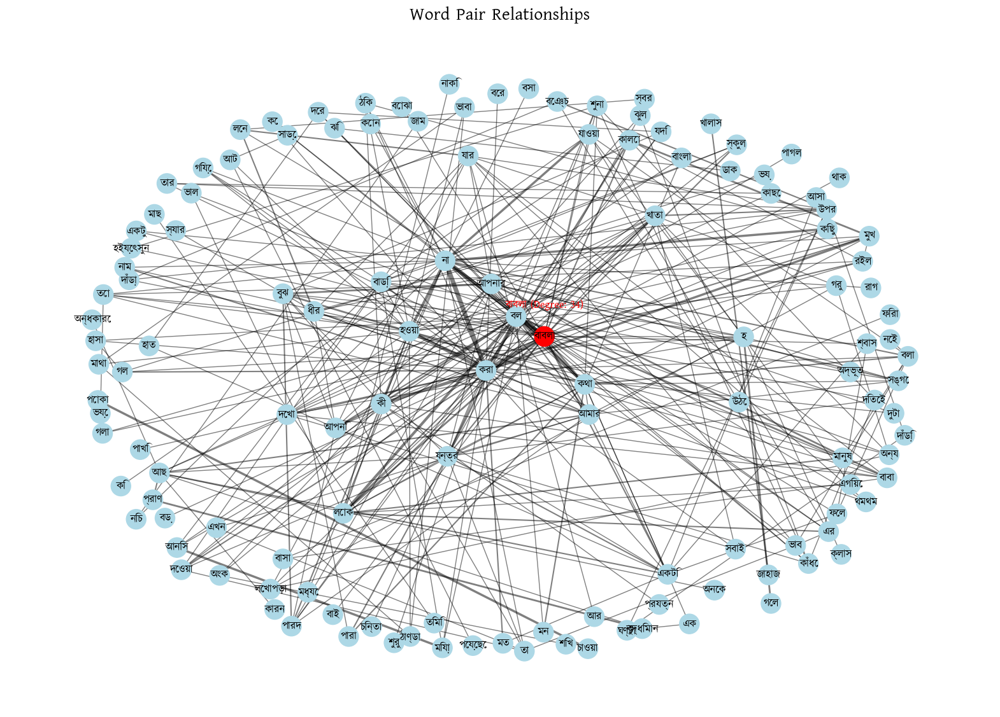

The node with the minimum degree between 10 and 20 is: হ with degree 10


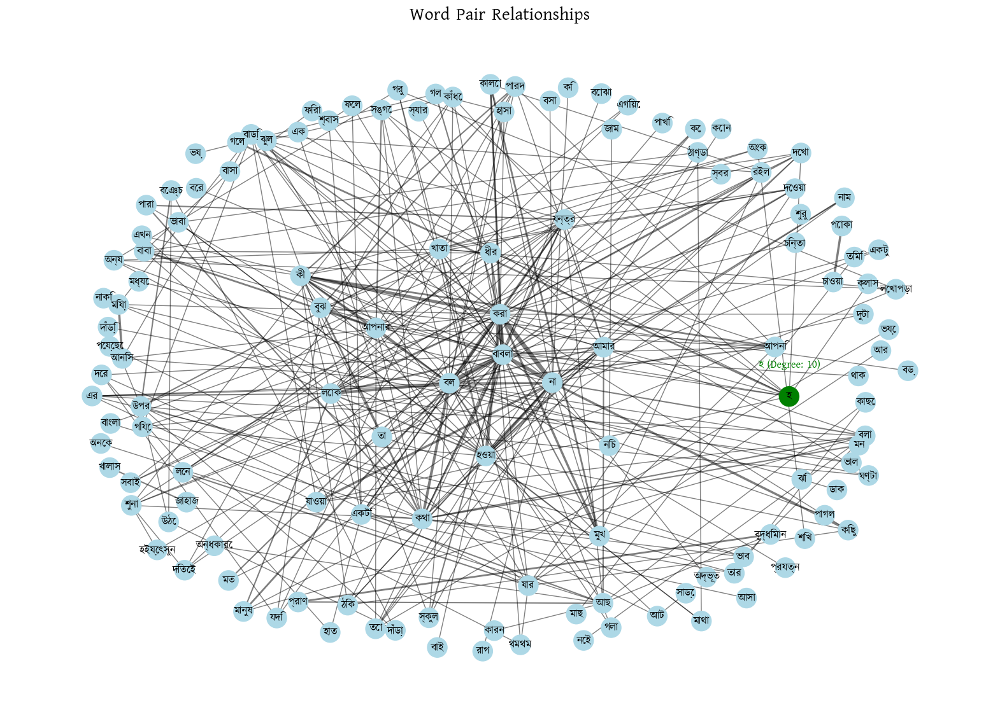

In [23]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    logger.info(f"Pair frequency: {dict(pair_frequency)}")  # Debugging: Print the word pairs and their frequencies
    return pair_frequency

# Function to find the node with the highest degree in the graph
def find_highest_degree_node(pair_frequency):
    # Create a graph using the pair frequencies
    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:  # Consider edges that appear more than once
            G.add_edge(pair[0], pair[1], weight=frequency)

    if not G.nodes:
        logger.error("Graph is empty. No valid edges were added.")
        return None

    # Find the node with the highest degree
    degrees = G.degree()  # Get degree of each node
    highest_degree_node = max(degrees, key=lambda x: x[1])  # Find the node with the max degree
    return highest_degree_node

# Function to plot nodes with Bangla labels and highlight highest degree node
def plot_nodes(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    # Find and print the node with the highest degree
    highest_degree_node = find_highest_degree_node(pair_frequency)
    if highest_degree_node:
        print(f"The node with the highest degree is: {highest_degree_node[0]} with degree {highest_degree_node[1]}")

        pos = nx.spring_layout(G, k=2)
        weights = nx.get_edge_attributes(G, 'weight').values()

        plt.figure(figsize=(20, 14))

        # Draw network nodes with a different color for the highest degree node
        node_colors = ['red' if node == highest_degree_node[0] else 'lightblue' for node in G.nodes()]
        nx.draw_networkx_nodes(G, pos, node_size=500, node_color=node_colors)

        # Draw edges with weights
        nx.draw_networkx_edges(G, pos, width=[w / 2 for w in weights], alpha=0.5)

        # Draw labels with Bangla font
        nx.draw_networkx_labels(G, pos, font_size=12, font_family=plt.rcParams['font.family'])

        # Annotate the highest degree node
        plt.text(
            pos[highest_degree_node[0]][0],
            pos[highest_degree_node[0]][1] + 0.1,
            f"{highest_degree_node[0]} (Degree: {highest_degree_node[1]})",
            fontsize=12, color='red', ha='center'
        )

        plt.title('Word Pair Relationships', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
        plt.axis('off')
        plt.show()
    else:
        print("No nodes found with a valid degree.")

# New function to plot and print the node with a degree between 10 and 20
def plot_minimum_degree_node(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the degrees of the nodes
    degrees = G.degree()

    # Filter nodes with degree between 10 and 20
    filtered_degrees = {node: degree for node, degree in degrees if 10 <= degree <= 20}

    if filtered_degrees:
        # Find the node with the minimum degree within this range
        minimum_degree_node = min(filtered_degrees, key=filtered_degrees.get)
        minimum_degree = filtered_degrees[minimum_degree_node]
        print(f"The node with the minimum degree between 10 and 20 is: {minimum_degree_node} with degree {minimum_degree}")

        # Plotting the graph
        pos = nx.spring_layout(G, k=2)
        weights = nx.get_edge_attributes(G, 'weight').values()

        plt.figure(figsize=(20, 14))

        # Draw network nodes with a different color for the minimum degree node
        node_colors = ['green' if node == minimum_degree_node else 'lightblue' for node in G.nodes()]
        nx.draw_networkx_nodes(G, pos, node_size=500, node_color=node_colors)

        # Draw edges with weights
        nx.draw_networkx_edges(G, pos, width=[w / 2 for w in weights], alpha=0.5)

        # Draw labels with Bangla font
        nx.draw_networkx_labels(G, pos, font_size=12, font_family=plt.rcParams['font.family'])

        # Annotate the minimum degree node
        plt.text(
            pos[minimum_degree_node][0],
            pos[minimum_degree_node][1] + 0.1,
            f"{minimum_degree_node} (Degree: {minimum_degree})",
            fontsize=12, color='green', ha='center'
        )

        plt.title('Word Pair Relationships', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
        plt.axis('off')
        plt.show()
    else:
        print("No node found with a degree between 10 and 20.")

# Example usage
# Path to the Kalpurush font (replace with your font path)
font_path = 'kalpurush.ttf'



# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Plot nodes with Bangla labels and print highest degree node
plot_nodes(pair_frequency, font_path)

# Plot nodes with Bangla labels and print minimum degree node between 10 and 20
plot_minimum_degree_node(pair_frequency, font_path)


# CHROMATIC NUMBER

Total number of nodes: 131
Chromatic number: 6


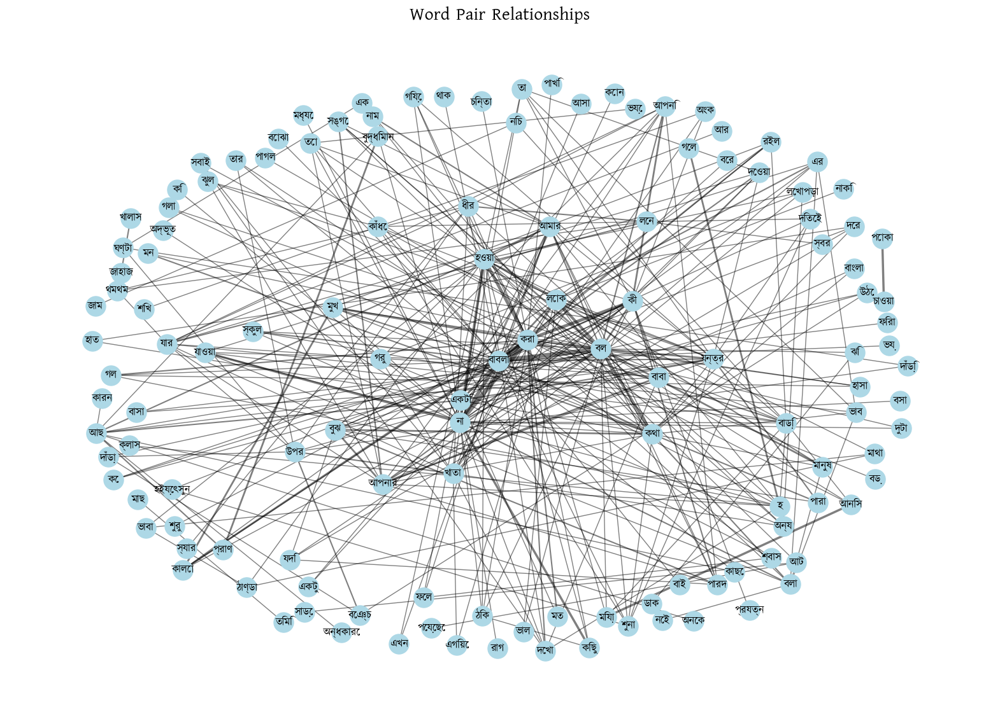

In [24]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to plot nodes with Bangla labels
def plot_nodes(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    # Calculate the chromatic number
    color_map = nx.coloring.greedy_color(G, strategy='largest_first')
    chromatic_number = max(color_map.values()) + 1
    print(f"Chromatic number: {chromatic_number}")

    pos = nx.spring_layout(G, k=2)
    weights = nx.get_edge_attributes(G, 'weight').values()

    plt.figure(figsize=(20, 14))

    # Draw network nodes
    nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightblue')

    # Draw edges with weights
    nx.draw_networkx_edges(G, pos, width=[w / 2 for w in weights], alpha=0.5)

    # Draw labels with Bangla font
    nx.draw_networkx_labels(G, pos, font_size=12, font_family=plt.rcParams['font.family'])

    plt.title('Word Pair Relationships', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
    plt.axis('off')
    plt.show()


# Path to the Kalpurush font (replace with your font path)
font_path = 'kalpurush.ttf'


# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Plot nodes with Bangla labels and calculate chromatic number
plot_nodes(pair_frequency, font_path)


# CHROMATIC INDEX

In [25]:
!pip install --upgrade networkx

Total number of nodes: 131
Chromatic index: 34


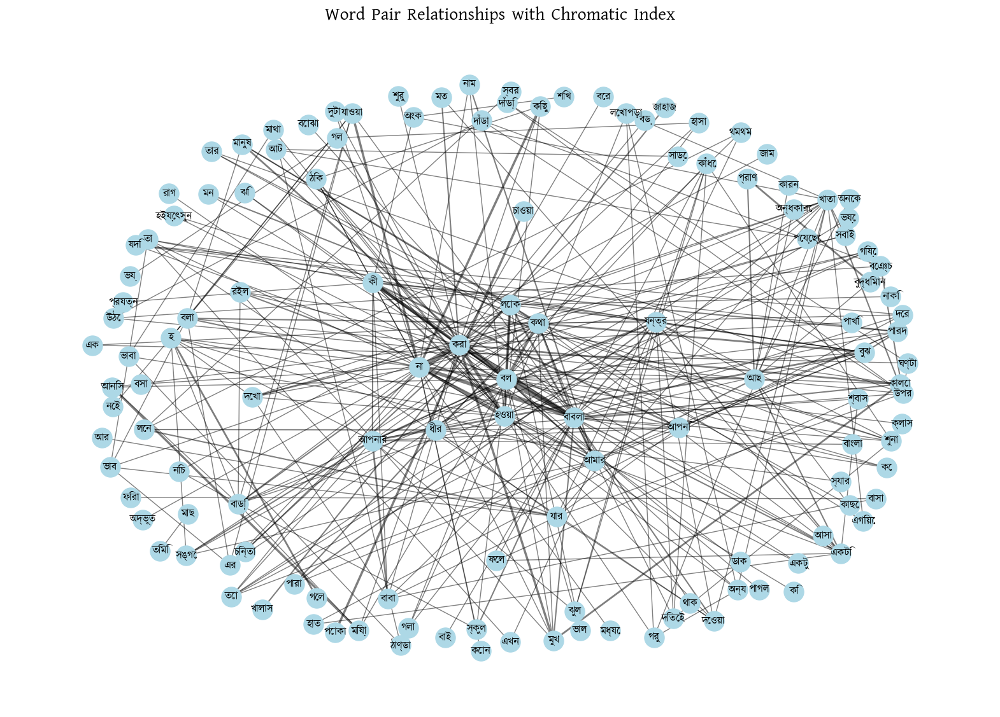

In [26]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to plot nodes with Bangla labels and calculate chromatic index
def plot_nodes_and_chromatic_index(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    # Create line graph of G, where nodes represent edges of G
    L = nx.line_graph(G)

    # Calculate the chromatic index (edge coloring) using greedy coloring on the line graph
    edge_color_map = nx.coloring.greedy_color(L, strategy='largest_first')

    chromatic_index = max(edge_color_map.values()) + 1
    print(f"Chromatic index: {chromatic_index}")

    pos = nx.spring_layout(G, k=2)
    weights = nx.get_edge_attributes(G, 'weight').values()

    plt.figure(figsize=(20, 14))

    # Draw network nodes
    nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightblue')

    # Draw edges with weights
    nx.draw_networkx_edges(G, pos, width=[w / 2 for w in weights], alpha=0.5)

    # Draw labels with Bangla font
    nx.draw_networkx_labels(G, pos, font_size=12, font_family=plt.rcParams['font.family'])

    plt.title('Word Pair Relationships with Chromatic Index', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
    plt.axis('off')
    plt.show()

# Path to the Kalpurush font (replace with your font path)
font_path = 'kalpurush.ttf'

# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Plot nodes with Bangla labels and calculate chromatic index
plot_nodes_and_chromatic_index(pair_frequency, font_path)


# DEGENARACY

### In graph theory, a k-degenerate graph is an undirected graph in which every subgraph has at least one vertex of degree at most k: that is, some vertex in the subgraph touches k or fewer of the subgraph's edges. The degeneracy of a graph is the smallest value of k for which it is k-degenerate. The degeneracy of a graph is a measure of how sparse it is, and is within a constant factor of other sparsity measures such as the arboricity of a graph.

Total number of nodes: 131
Graph Degeneracy: 6
Number of edges: 322
Average degree: 4.92


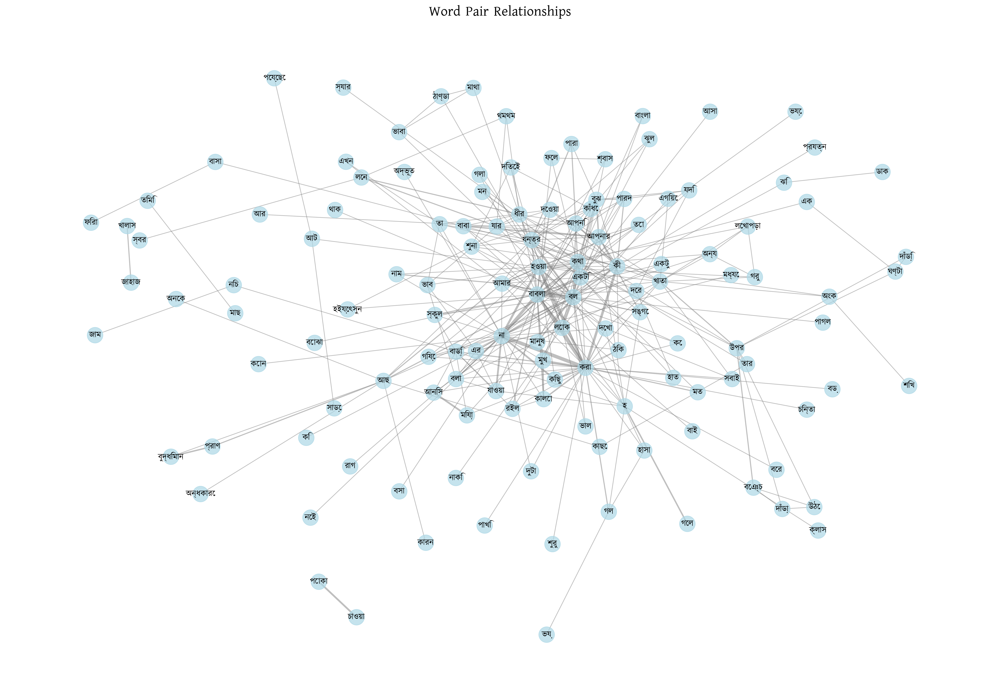

In [27]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(sentences):
    pair_frequency = defaultdict(int)
    for sentence in sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to calculate degeneracy of the graph
def calculate_degeneracy(G):
    """
    Calculate the degeneracy of a graph.
    Degeneracy is the smallest k such that the graph has a k-degenerate ordering.
    """
    # Create a copy of the graph to avoid modifying the original
    graph = G.copy()

    # Track the maximum degree encountered during node removal
    degeneracy = 0
    core_numbers = {}

    # Iteratively remove nodes with minimum degree
    while graph.number_of_nodes() > 0:
        # Find the node with the minimum degree
        degree_dict = dict(graph.degree())
        if not degree_dict:
            break

        min_degree = min(degree_dict.values())
        min_degree_nodes = [n for n, d in degree_dict.items() if d == min_degree]

        # If multiple nodes have the same minimum degree, choose one
        min_degree_node = min_degree_nodes[0]

        # Update degeneracy with the current node's degree
        core_numbers[min_degree_node] = min_degree
        degeneracy = max(degeneracy, graph.degree(min_degree_node))

        # Remove the node with minimum degree
        graph.remove_node(min_degree_node)

    return degeneracy

# Function to plot nodes with Bangla labels
def plot_nodes(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    # Create graph using pair frequencies
    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")

    # Calculate and print graph metrics
    graph_degeneracy = calculate_degeneracy(G)
    print(f"Graph Degeneracy: {graph_degeneracy}")

    # Additional graph metrics
    print(f"Number of edges: {G.number_of_edges()}")
    print(f"Average degree: {sum(dict(G.degree()).values()) / total_nodes:.2f}")

    # Visualization
    pos = nx.spring_layout(G, k=0.5, iterations=50)
    weights = list(nx.get_edge_attributes(G, 'weight').values())

    plt.figure(figsize=(20, 14), dpi=300)

    # Draw network nodes
    nx.draw_networkx_nodes(G, pos,
                            node_size=500,
                            node_color='lightblue',
                            alpha=0.7)

    # Draw edges with weights
    nx.draw_networkx_edges(G, pos,
                            width=[w / 2 for w in weights],
                            alpha=0.5,
                            edge_color='gray')

    # Draw labels with Bangla font
    nx.draw_networkx_labels(G, pos,
                             font_size=12,
                             font_family=plt.rcParams['font.family'])

    plt.title('Word Pair Relationships',
              fontdict={'fontsize': 20, 'fontweight': 'bold'},
              fontfamily=plt.rcParams['font.family'])
    plt.axis('off')
    plt.tight_layout()
    plt.show()

# Path to the Kalpurush font (replace with your font path)
font_path = 'kalpurush.ttf'

# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Plot nodes with Bangla labels
plot_nodes(pair_frequency, font_path)

# DENSITY

### To calculate the density of a graph, you can use the formula:

Density
=
2
×
Number of edges
Number of nodes
×
(
Number of nodes
−
1
)
Density=
Number of nodes×(Number of nodes−1)
2×Number of edges
​


Total number of nodes: 131
Graph Density: 0.0378


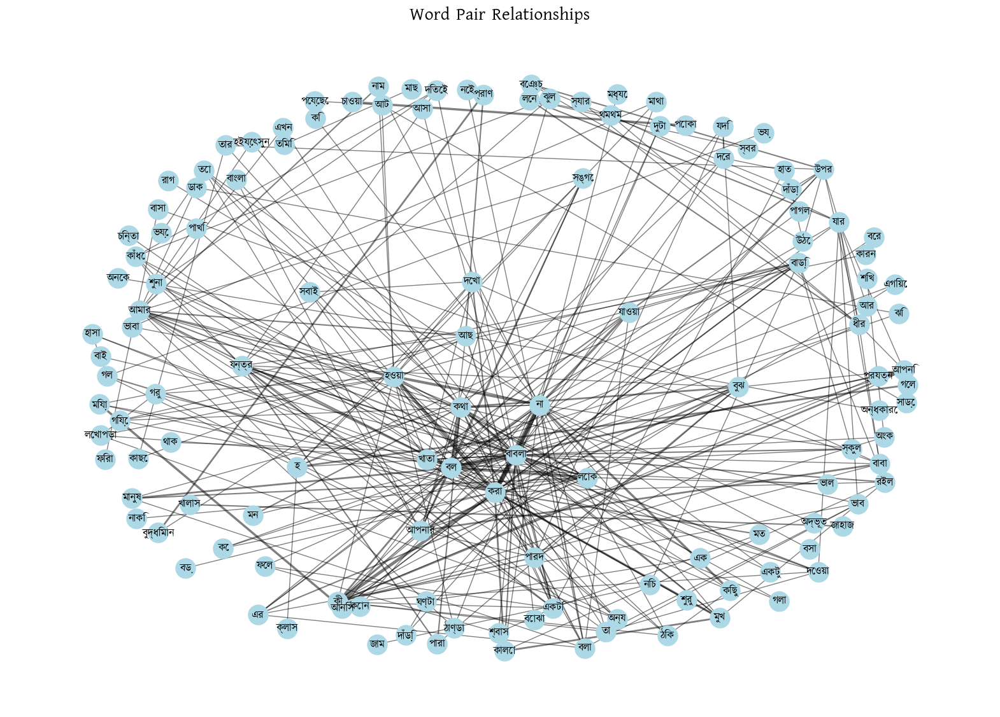

In [28]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to plot nodes with Bangla labels and calculate graph density
def plot_nodes(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    # Calculate graph density
    total_edges = len(G.edges)
    density = 2 * total_edges / (total_nodes * (total_nodes - 1)) if total_nodes > 1 else 0
    print(f"Graph Density: {density:.4f}")

    pos = nx.spring_layout(G, k=2)
    weights = nx.get_edge_attributes(G, 'weight').values()

    plt.figure(figsize=(20, 14))

    # Draw network nodes
    nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightblue')

    # Draw edges with weights
    nx.draw_networkx_edges(G, pos, width=[w / 2 for w in weights], alpha=0.5)

    # Draw labels with Bangla font
    nx.draw_networkx_labels(G, pos, font_size=12, font_family=plt.rcParams['font.family'])

    plt.title('Word Pair Relationships', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
    plt.axis('off')
    plt.show()


# Path to the Kalpurush font (replace with your font path)
font_path = 'kalpurush.ttf'



# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Plot nodes with Bangla labels and calculate graph density
plot_nodes(pair_frequency, font_path)


# EDGE CUT, VERTEX CUT, EDGE CONNECTIVITY, VERTEX CONNECTIVITY, MATCHING, PERFECT MSATCHING

In [29]:
import networkx as nx
from itertools import combinations
from collections import defaultdict


# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Create a graph from word pairs
def create_graph(pair_frequency):
    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:  # Only include pairs with a frequency greater than 1
            G.add_edge(pair[0], pair[1], weight=frequency)
    return G

# Function to find edge cut
def edge_cut(G):
    # Placeholder for edge cut logic, modify as necessary
    return list(G.edges())

# Function to find vertex cut
def vertex_cut(G):
    # Placeholder for vertex cut logic, modify as necessary
    return list(G.nodes())

# Function to find edge cover
def edge_cover(G):
    # Placeholder for edge cover logic, modify as necessary
    return list(G.edges())

# Function to find vertex cover
def vertex_cover(G):
    # Placeholder for vertex cover logic, modify as necessary
    return list(G.nodes())

# Function to find matching
def matching(G):
    return list(nx.max_weight_matching(G))

# Function to check if perfect matching is possible
def perfect_matching(G):
    # Check if the graph is bipartite
    if nx.is_bipartite(G):
        matching_set = nx.max_weight_matching(G)
        if len(matching_set) == len(G.nodes) // 2:  # Perfect matching condition
            return "Perfect matching found"
        else:
            return "Perfect matching not possible"
    else:
        return "Graph is not bipartite, cannot have a perfect matching"

# Main execution
pair_frequency = check_pair_frequency(cleaned_sentences)
G = create_graph(pair_frequency)

# Print graph properties
print(f"Edge Cut: {edge_cut(G)}")
print(f"Vertex Cut: {vertex_cut(G)}")
print(f"Edge Cover: {edge_cover(G)}")
print(f"Vertex Cover: {vertex_cover(G)}")
print(f"Matching: {matching(G)}")
print(f"Perfect Matching: {perfect_matching(G)}")


Edge Cut: [('খাতা', 'অংক'), ('খাতা', 'যার'), ('খাতা', 'দেওয়া'), ('খাতা', 'ধীর'), ('খাতা', 'উপর'), ('খাতা', 'বাবলা'), ('খাতা', 'দেখা'), ('খাতা', 'সবাই'), ('খাতা', 'করা'), ('খাতা', 'এগিয়ে'), ('খাতা', 'লোক'), ('খাতা', 'গরু'), ('খাতা', 'অন্য'), ('খাতা', 'লেখাপড়া'), ('খাতা', 'হওয়া'), ('অংক', 'কী'), ('অংক', 'শিখ'), ('সাড়ে', 'আট'), ('আট', 'পেয়েছে'), ('আট', 'হওয়া'), ('যার', 'দেওয়া'), ('যার', 'ধীর'), ('যার', 'উপর'), ('যার', 'লেন'), ('যার', 'আপনি'), ('যার', 'থমথম'), ('যার', 'আর'), ('যার', 'ভাব'), ('যার', 'বাবা'), ('যার', 'আপনার'), ('দেওয়া', 'বাবলা'), ('দেওয়া', 'কী'), ('দেওয়া', 'যন্ত্র'), ('দেওয়া', 'তা'), ('ধীর', 'উপর'), ('ধীর', 'করা'), ('ধীর', 'লেন'), ('ধীর', 'স্যার'), ('ধীর', 'আপনি'), ('ধীর', 'থমথম'), ('ধীর', 'বাবা'), ('উপর', 'দাঁড়া'), ('উপর', 'বেঞ্চ'), ('উপর', 'উঠে'), ('উপর', 'দাঁড়ি'), ('উপর', 'ঘণ্টা'), ('উপর', 'তার'), ('বড়', 'করা'), ('করা', 'কালো'), ('করা', 'দেখা'), ('করা', 'সবাই'), ('করা', 'মুখ'), ('করা', 'কে'), ('করা', 'মত'), ('করা', 'বাবলা'), ('করা', 'গল'), ('করা', 'একটি'), ('করা', 'ক

# GLOBAL CLUSTERING CO-EFFICIENT, H-INDEX

### Global Clustering Coefficient and H-index for your graph, we can define two additional functions:

Global Clustering Coefficient: The global clustering coefficient measures the degree to which nodes in a graph tend to cluster together. It can be computed using the formula:
𝐶
=
3
×
Number of triangles in the graph
Number of connected triples of nodes
C=
Number of connected triples of nodes
3×Number of triangles in the graph
​

NetworkX has a built-in method to compute the global clustering coefficient.

H-index: The H-index is a measure of the productivity and citation impact of the publications of a researcher or scholar. In the context of graph theory, the H-index can be computed as the maximum integer
ℎ
h such that a node has at least
ℎ
h neighbors with degree at least
ℎ
h. It’s useful for networks where you want to measure a node’s influence based on its connections.

Total number of nodes: 131
Graph Density: 0.0378
Global Clustering Coefficient: 0.3879
H-index: 12


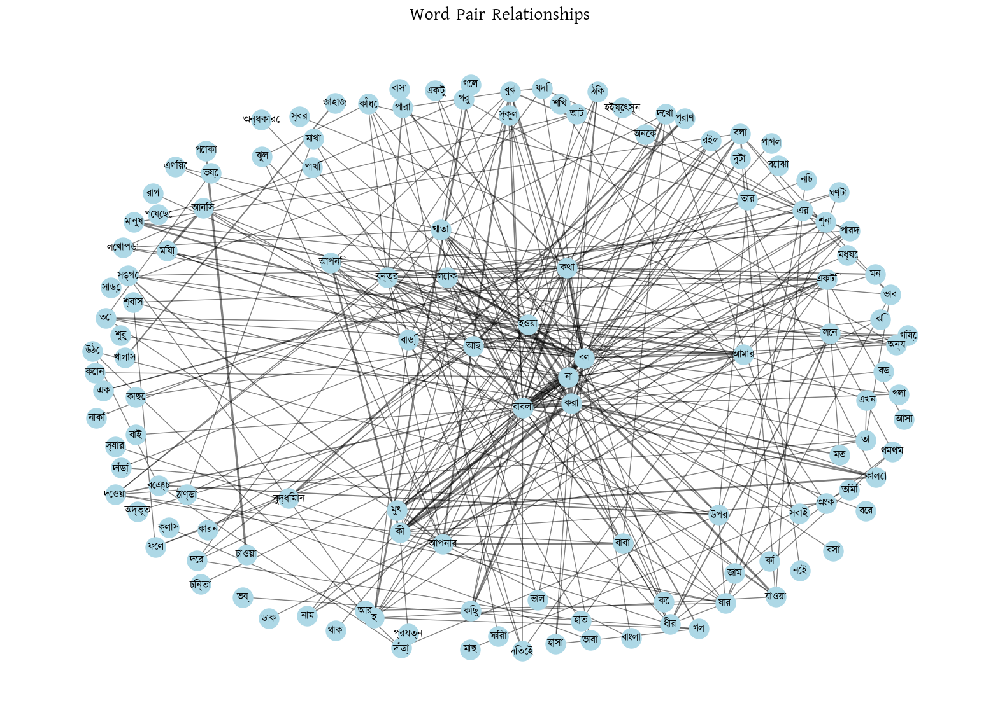

In [30]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to plot nodes with Bangla labels and calculate graph density
def plot_nodes(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    # Calculate graph density
    total_edges = len(G.edges)
    density = 2 * total_edges / (total_nodes * (total_nodes - 1)) if total_nodes > 1 else 0
    print(f"Graph Density: {density:.4f}")

    # Calculate Global Clustering Coefficient
    clustering_coefficient = nx.average_clustering(G)
    print(f"Global Clustering Coefficient: {clustering_coefficient:.4f}")

    # Calculate H-index
    h_index_value = calculate_h_index(G)
    print(f"H-index: {h_index_value}")

    pos = nx.spring_layout(G, k=2)
    weights = nx.get_edge_attributes(G, 'weight').values()

    plt.figure(figsize=(20, 14))

    # Draw network nodes
    nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightblue')

    # Draw edges with weights
    nx.draw_networkx_edges(G, pos, width=[w / 2 for w in weights], alpha=0.5)

    # Draw labels with Bangla font
    nx.draw_networkx_labels(G, pos, font_size=12, font_family=plt.rcParams['font.family'])

    plt.title('Word Pair Relationships', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
    plt.axis('off')
    plt.show()

# Function to calculate H-index
def calculate_h_index(G):
    degrees = [d for n, d in G.degree()]
    degrees.sort(reverse=True)

    h_index = 0
    for i, degree in enumerate(degrees):
        if degree >= i + 1:
            h_index = i + 1
        else:
            break
    return h_index

# Path to the Kalpurush font (replace with your font path)
font_path = 'kalpurush.ttf'



# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Plot nodes with Bangla labels and calculate graph density, clustering coefficient, and H-index
plot_nodes(pair_frequency, font_path)


# CLIQUE

### Clique Number, Maximal Clique Number, and Maximum Clique in your graph, we can define three new functions:

Clique Number: This is the size of the largest complete subgraph (clique) in the graph, which is essentially the largest number of nodes that are all adjacent to each other.

Maximal Clique Number: This is the size of the largest clique in the graph that cannot be extended by adding any adjacent nodes.

Maximum Clique: This refers to the largest clique (in terms of number of nodes) that exists in the graph.

Total number of nodes: 131
Graph Density: 0.0378
Global Clustering Coefficient: 0.3879
H-index: 12
Clique Number: 6
Maximal Clique Number: 6
Maximum Clique: ['আপনার', 'বল', 'বুঝ', 'আপনি', 'পারদ', 'কী']


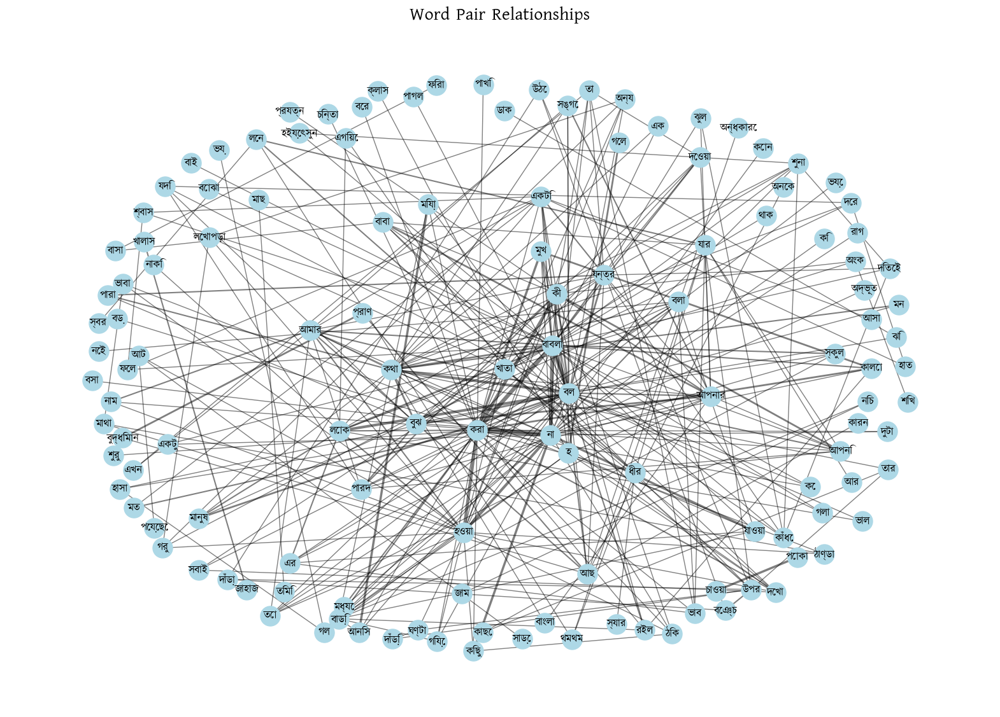

In [31]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to plot nodes with Bangla labels and calculate graph density
def plot_nodes(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    # Calculate graph density
    total_edges = len(G.edges)
    density = 2 * total_edges / (total_nodes * (total_nodes - 1)) if total_nodes > 1 else 0
    print(f"Graph Density: {density:.4f}")

    # Calculate Global Clustering Coefficient
    clustering_coefficient = nx.average_clustering(G)
    print(f"Global Clustering Coefficient: {clustering_coefficient:.4f}")

    # Calculate H-index
    h_index_value = calculate_h_index(G)
    print(f"H-index: {h_index_value}")

    # Calculate Clique Number, Maximal Clique Number, and Maximum Clique
    clique_number, maximal_clique_number, maximum_clique = calculate_clique_metrics(G)
    print(f"Clique Number: {clique_number}")
    print(f"Maximal Clique Number: {maximal_clique_number}")
    print(f"Maximum Clique: {maximum_clique}")

    pos = nx.spring_layout(G, k=2)
    weights = nx.get_edge_attributes(G, 'weight').values()

    plt.figure(figsize=(20, 14))

    # Draw network nodes
    nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightblue')

    # Draw edges with weights
    nx.draw_networkx_edges(G, pos, width=[w / 2 for w in weights], alpha=0.5)

    # Draw labels with Bangla font
    nx.draw_networkx_labels(G, pos, font_size=12, font_family=plt.rcParams['font.family'])

    plt.title('Word Pair Relationships', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
    plt.axis('off')
    plt.show()

# Function to calculate H-index
def calculate_h_index(G):
    degrees = [d for n, d in G.degree()]
    degrees.sort(reverse=True)

    h_index = 0
    for i, degree in enumerate(degrees):
        if degree >= i + 1:
            h_index = i + 1
        else:
            break
    return h_index

# Function to calculate Clique Metrics (Clique Number, Maximal Clique Number, and Maximum Clique)
def calculate_clique_metrics(G):
    cliques = list(nx.find_cliques(G))

    # Clique Number: Size of the largest clique in the graph
    clique_number = max(len(clique) for clique in cliques) if cliques else 0

    # Maximal Clique Number: Size of the largest maximal clique
    maximal_clique_number = 0
    for clique in cliques:
        # Check if the subgraph induced by the clique is a complete graph
        subgraph = G.subgraph(clique)
        if is_maximal_clique(G, clique):
            maximal_clique_number = max(maximal_clique_number, len(clique))

    # Maximum Clique: The actual nodes in the largest clique
    maximum_clique = max(cliques, key=len) if cliques else []

    return clique_number, maximal_clique_number, maximum_clique

# Function to check if a clique is maximal (i.e., it cannot be extended by adding one more node)
def is_maximal_clique(G, clique):
    # Check if adding any other node from the graph creates a larger clique
    for node in G.nodes():
        if node not in clique and all((node in G.neighbors(v)) for v in clique):
            return False
    return True

# Path to the Kalpurush font (replace with your font path)
font_path = 'kalpurush.ttf'



# Generate pair frequency
pair_frequency = check_pair_frequency(cleaned_sentences)

# Plot nodes with Bangla labels and calculate graph density, clustering coefficient, H-index, and clique metrics
plot_nodes(pair_frequency, font_path)


Total number of nodes: 131
Graph Density: 0.037815619495008806
Global Clustering Coefficient: 0.3878751011815402
H-index: 13


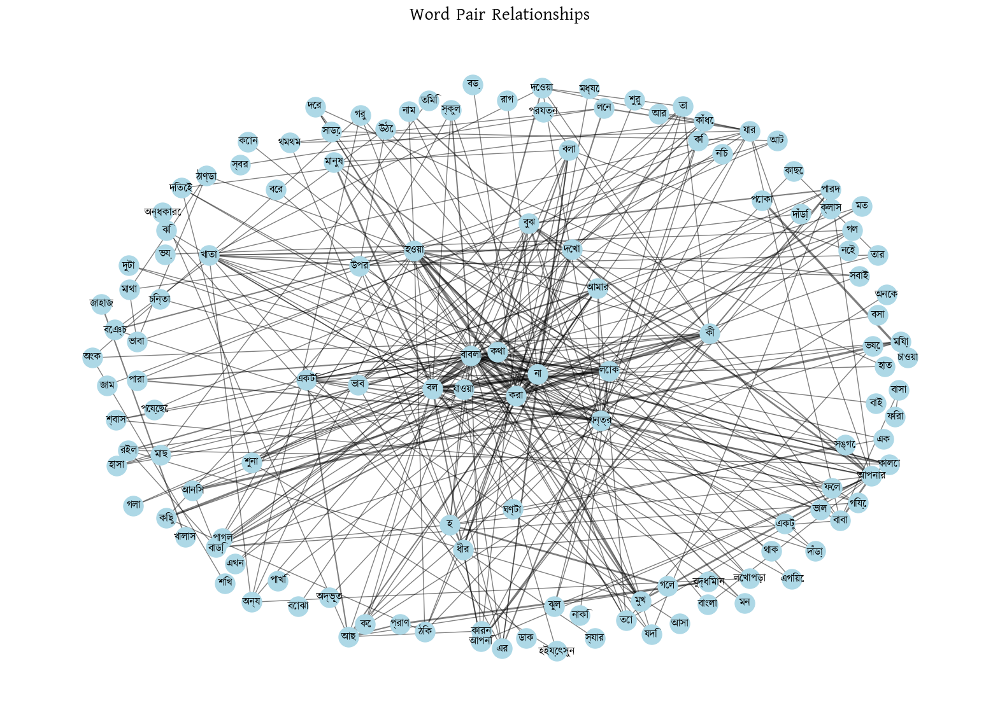

Clique Number: 6
Maximal Clique Number: 6
Maximal Clique Nodes: আপনার, বল, বুঝ, আপনি, পারদ, কী
Maximum Clique Number: 6
Maximum Clique Nodes: আপনার, বল, বুঝ, আপনি, পারদ, কী


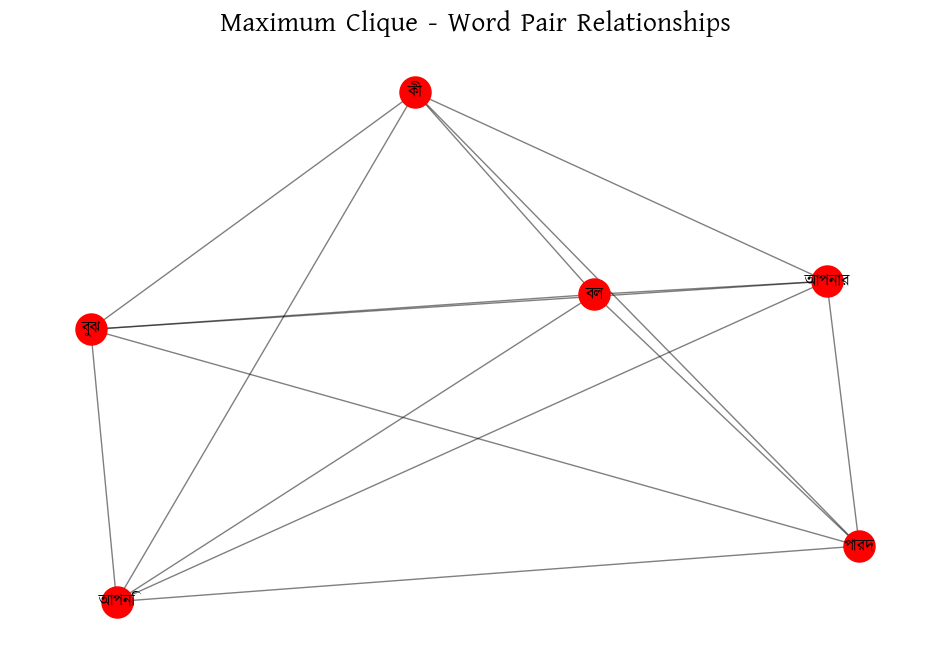

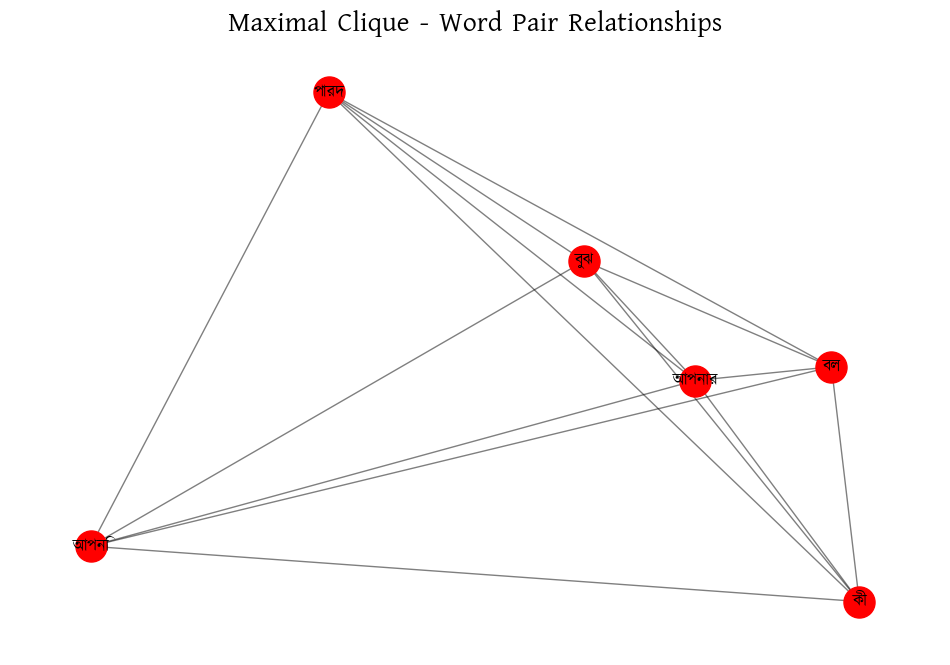

In [32]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
from itertools import combinations
import logging
from pathlib import Path
import matplotlib.font_manager as fm

# Logging setup
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Function to set up custom font for Bangla
def custom_font(font_path):
    try:
        font_path = Path(font_path)
        if not font_path.exists():
            logger.error(f"Font file not found: {font_path}")
            return None

        # Load and register the font
        font_prop = fm.FontProperties(fname=str(font_path))
        font_name = font_prop.get_name()
        fm.fontManager.addfont(str(font_path))

        plt.rcParams['font.family'] = font_name
        logger.info(f"Font loaded successfully: {font_name}")
        return font_name
    except Exception as e:
        logger.error(f"Error loading font: {e}")
        return None

# Function to check frequency of word pairs
def check_pair_frequency(cleaned_sentences):
    pair_frequency = defaultdict(int)
    for sentence in cleaned_sentences:
        words = sentence.split()
        unique_words = set(words)  # Get unique words in the sentence
        word_pairs = combinations(unique_words, 2)
        for pair in word_pairs:
            pair_frequency[pair] += 1
    return pair_frequency

# Function to plot nodes with Bangla labels
def plot_nodes(pair_frequency, font_path):
    # Load custom Bangla font
    font_name = custom_font(font_path)
    if not font_name:
        logger.warning("Could not load font. Falling back to default font.")

    G = nx.Graph()
    for pair, frequency in pair_frequency.items():
        if frequency > 1:
            G.add_edge(pair[0], pair[1], weight=frequency)

    # Get the total number of nodes
    total_nodes = len(G.nodes)
    print(f"Total number of nodes: {total_nodes}")  # Print total number of nodes

    # Graph density
    density = nx.density(G)
    print(f"Graph Density: {density}")

    # Global Clustering Coefficient
    clustering_coefficient = nx.average_clustering(G)
    print(f"Global Clustering Coefficient: {clustering_coefficient}")

    # H-index (degree-based)
    degrees = [d for _, d in G.degree()]
    h_index = sum(d >= h for h, d in enumerate(sorted(degrees, reverse=True)))
    print(f"H-index: {h_index}")

    pos = nx.spring_layout(G, k=2)
    weights = nx.get_edge_attributes(G, 'weight').values()

    plt.figure(figsize=(20, 14))

    # Draw network nodes
    nx.draw_networkx_nodes(G, pos, node_size=500, node_color='lightblue')

    # Draw edges with weights
    nx.draw_networkx_edges(G, pos, width=[w / 2 for w in weights], alpha=0.5)

    # Draw labels with Bangla font
    nx.draw_networkx_labels(G, pos, font_size=12, font_family=plt.rcParams['font.family'])

    plt.title('Word Pair Relationships', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
    plt.axis('off')
    plt.show()

# Function to check if a clique is maximal
def is_maximal_clique(G, clique):
    subgraph = G.subgraph(clique)
    # Check if the subgraph is a clique by comparing its number of edges
    # to the number of edges in a complete graph with the same number of nodes.
    num_nodes = len(clique)
    num_edges = subgraph.number_of_edges()

    if num_edges != num_nodes * (num_nodes - 1) // 2:
        return False

    for node in G.nodes:
        if node not in clique and all((node, n) in G.edges() for n in clique):
            return False
    return True

# Function to calculate Clique Metrics (Clique Number, Maximal Clique Number, and Maximum Clique)
def calculate_clique_metrics(G):
    cliques = list(nx.find_cliques(G))

    # Clique Number: Size of the largest clique in the graph
    clique_number = max(len(clique) for clique in cliques) if cliques else 0

    # Maximal Clique Number: Size of the largest maximal clique
    maximal_clique_number = 0
    maximal_clique = []
    for clique in cliques:
        # Check if the subgraph induced by the clique is a complete graph
        subgraph = G.subgraph(clique)
        if is_maximal_clique(G, clique):
            maximal_clique_number = max(maximal_clique_number, len(clique))
            if len(clique) == maximal_clique_number:
                maximal_clique = clique

    # Maximum Clique: The actual nodes in the largest clique
    maximum_clique = max(cliques, key=len) if cliques else []

    return clique_number, maximal_clique_number, maximal_clique, maximum_clique

# Function to plot clique nodes
def plot_clique(G, clique_nodes, title):
    pos = nx.spring_layout(G, k=2)

    # Create a subgraph from the clique nodes
    clique_subgraph = G.subgraph(clique_nodes)

    plt.figure(figsize=(12, 8))

    # Draw the clique subgraph nodes in red
    nx.draw_networkx_nodes(clique_subgraph, pos, node_size=500, node_color='red')

    # Draw edges of the clique
    nx.draw_networkx_edges(clique_subgraph, pos, alpha=0.5)

    # Draw labels for the clique nodes
    nx.draw_networkx_labels(clique_subgraph, pos, font_size=12, font_family=plt.rcParams['font.family'])

    plt.title(f'{title} - Word Pair Relationships', fontdict={'fontsize': 20, 'fontweight': 'bold'}, fontfamily=plt.rcParams['font.family'])
    plt.axis('off')
    plt.show()

pair_frequency = check_pair_frequency(cleaned_sentences)

# Path to the Kalpurush font (replace with your font path)
font_path = 'kalpurush.ttf'

# Plot nodes with Bangla labels and calculate graph density, clustering coefficient, H-index, and clique metrics
plot_nodes(pair_frequency, font_path)

# Calculate clique metrics and plot maximum and maximal cliques
G = nx.Graph()
for pair, frequency in pair_frequency.items():
    if frequency > 1:
        G.add_edge(pair[0], pair[1], weight=frequency)

clique_number, maximal_clique_number, maximal_clique, maximum_clique = calculate_clique_metrics(G)
print(f"Clique Number: {clique_number}")
print(f"Maximal Clique Number: {maximal_clique_number}")
print(f"Maximal Clique Nodes: {', '.join(maximal_clique)}")
print(f"Maximum Clique Number: {len(maximum_clique)}")
print(f"Maximum Clique Nodes: {', '.join(maximum_clique)}")

# Plot maximum clique
plot_clique(G, maximum_clique, "Maximum Clique")

# Plot maximal clique (subgraph of maximal clique)
plot_clique(G, maximal_clique, "Maximal Clique")
